# Load segmentation, localise and save as h5

Segment a stack of images and then manually label a couple, then check how well the model segmented them.

In [8]:
import napari
from cellpose import models
from octopuslite import utils, tile
import numpy as np
import os

import sys
sys.path.append('macrohet/')
from notify import send_sms

def view(img):
    return napari.Viewer().add_image(img)

from tqdm.auto import tqdm

import btrack
import dask.array as da

from skimage.transform import rescale, resize, downscale_local_mean
import sys
sys.path.append('../')
from notify import send_sms

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

### Load experiment of choice

The Opera Phenix is a high-throughput confocal microscope that acquires very large 5-dimensional (TCZXY) images over several fields of view in any one experiment. Therefore, a lazy-loading approach is chosen to mosaic, view and annotate these images. This approach depends upon Dask and DaskFusion. The first step is to load the main metadata file (typically called `Index.idx.xml` and located in the main `Images` directory) that contains the image filenames and associated TCXZY information used to organise the images.

In [2]:
image_dir = '/mnt/DATA/sandbox/pierre_live_cell_data/outputs/Replication_IPSDM_GFP/Images/'
metadata_fn = '/mnt/DATA/sandbox/pierre_live_cell_data/outputs/Replication_IPSDM_GFP/Index.idx.xml'
metadata = utils.read_harmony_metadata(metadata_fn)

Reading metadata XML file...


Extracting HarmonyV5 metadata:   0%|          | 0/113400 [00:00<?, ?it/s]

Extracting metadata complete!


### View assay layout and mask information (optional)

The Opera Phenix acquires many time lapse series from a range of positions. The first step is to inspect the image metadata, presented in the form of an `Assaylayout/experiment_ID.xml` file, to show which positions correspond to which experimental assays.

In [3]:
metadata_path = '/mnt/DATA/sandbox/pierre_live_cell_data/outputs/Replication_IPSDM_GFP/Assaylayout/20210602_Live_cell_IPSDMGFP_ATB.xml'
assay_layout = utils.read_harmony_metadata(metadata_path, assay_layout=True)
utils.read_harmony_metadata(metadata_path, assay_layout=True)

Reading metadata XML file...
Extracting metadata complete!
Reading metadata XML file...
Extracting metadata complete!


Strain Compound Concentration ConcentrationEC
3 4    RD1     CTRL             0             EC0
  5     WT     CTRL             0             EC0
  6     WT      PZA            60            EC50
  7     WT      RIF           0.1            EC50
  8     WT      INH          0.04            EC50
  9     WT      BDQ          0.02            EC50
4 4    RD1     CTRL             0             EC0
  5     WT     CTRL             0             EC0
  6     WT      PZA            60            EC50
  7     WT      RIF           0.1            EC50
  8     WT      INH          0.04            EC50
  9     WT      BDQ          0.02            EC50
5 4    RD1     CTRL             0             EC0
  5     WT     CTRL             0             EC0
  6     WT      PZA           400            EC99
  7     WT      RIF             2            EC99
  8     WT      INH             2            EC99
  9     WT      BDQ           2.5            EC99
6 4    RD1     CTRL             0             EC0
  5     WT     CTRL             0             EC0
  6     WT      PZA           400            EC99
  7     WT      RIF             2            EC99
  8     WT      INH             2            EC99
  9     WT      BDQ           2.5            EC99

# Iteratively check tracks

In [4]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_theme(style="ticks")
sns.set_palette("Spectral")

In [55]:
for (row, column), info in tqdm(assay_layout.iterrows(), 
                                desc = 'Progress through positions',
                                total = len(assay_layout)):
    with btrack.dataio.HDF5FileHandler(
                                        f'/mnt/DATA/macrohet/segmentation/tracks_objs/({row},{column})_objects_rescaled.h5',#
                                        'r', 
                                        obj_type='obj_type_1',
                                        ) as hdf:                                                                                                                                                                                                                                                                                                                                                                                                                                                                          
                                        masks = hdf.segmentation
                                        objects = hdf.objects
    with btrack.dataio.HDF5FileHandler(
                                        f"/mnt/DATA/macrohet/segmentation/tracks_objs/({row},{column})_tracks_rescaled.h5", 
                                        'r', 
                                        obj_type = 'obj_type_1', 
                                        ) as hdf: 
                                        tracks = hdf.tracks
    ### check length of tracks 
    lengths = [len(track) for track in tracks]
    sns.histplot(lengths)
    plt.xlabel('Length of tracks')
    plt.ylabel('Frequency')
    sns.despine(offset=0) 
    plt.savefig(f'/mnt/DATA/macrohet/segmentation/full_localisation/track_stats/({row},{column})_track_lens.png', bbox_inches = 'tight', dpi = 314)
    plt.clf()
    
    ### write all out into one file
    with btrack.dataio.HDF5FileHandler(
                                    f'/mnt/DATA/macrohet/segmentation/full_localisation/({row},{column})_localisation.h5',#
                                    'w', 
                                    obj_type='obj_type_1',
                                    ) as hdf:                                                                                                                                                                                                                                                                                                                                                                                                                                                                          
                                        hdf.write_objects(objects)
                                        hdf.write_segmentation(masks)
                                        hdf.write_tracks(tracks)

Progress through positions:   0%|          | 0/24 [00:00<?, ?it/s]

[INFO][2023/01/30 10:15:37 AM] Opening HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(3,4)_objects_rescaled.h5...
[INFO][2023/01/30 10:15:37 AM] Loading segmentation (75, 1200, 1200)
[INFO][2023/01/30 10:15:37 AM] Loading objects/obj_type_1 (29079, 5) (29079 filtered: None)
[INFO][2023/01/30 10:15:38 AM] Closing HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(3,4)_objects_rescaled.h5
[INFO][2023/01/30 10:15:38 AM] Opening HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(3,4)_tracks_rescaled.h5...
[INFO][2023/01/30 10:15:38 AM] Loading tracks/obj_type_1
[INFO][2023/01/30 10:15:38 AM] Loading LBEP/obj_type_1
[INFO][2023/01/30 10:15:38 AM] Loading objects/obj_type_1 (29079, 5) (29079 filtered: None)
[INFO][2023/01/30 10:15:39 AM] Closing HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(3,4)_tracks_rescaled.h5
[INFO][2023/01/30 10:15:40 AM] Opening HDF file: /mnt/DATA/macrohet/segmentation/full_localisation/(3,4)_localisation.h5...
[INFO][2023/01/30 10:15:40 AM] 

[INFO][2023/01/30 10:16:05 AM] Loading segmentation (75, 1200, 1200)
[INFO][2023/01/30 10:16:05 AM] Loading objects/obj_type_1 (33027, 5) (33027 filtered: None)
[INFO][2023/01/30 10:16:07 AM] Closing HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(3,8)_objects_rescaled.h5
[INFO][2023/01/30 10:16:07 AM] Opening HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(3,8)_tracks_rescaled.h5...
[INFO][2023/01/30 10:16:07 AM] Loading tracks/obj_type_1
[INFO][2023/01/30 10:16:07 AM] Loading LBEP/obj_type_1
[INFO][2023/01/30 10:16:07 AM] Loading objects/obj_type_1 (33027, 5) (33027 filtered: None)
[INFO][2023/01/30 10:16:07 AM] Closing HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(3,8)_tracks_rescaled.h5
[INFO][2023/01/30 10:16:08 AM] Opening HDF file: /mnt/DATA/macrohet/segmentation/full_localisation/(3,8)_localisation.h5...
[INFO][2023/01/30 10:16:08 AM] Writing objects/obj_type_1
[INFO][2023/01/30 10:16:08 AM] Writing labels/obj_type_1
[INFO][2023/01/30 10:16:08 AM] Loading

[INFO][2023/01/30 10:16:34 AM] Closing HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(4,6)_objects_rescaled.h5
[INFO][2023/01/30 10:16:34 AM] Opening HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(4,6)_tracks_rescaled.h5...
[INFO][2023/01/30 10:16:34 AM] Loading tracks/obj_type_1
[INFO][2023/01/30 10:16:34 AM] Loading LBEP/obj_type_1
[INFO][2023/01/30 10:16:34 AM] Loading objects/obj_type_1 (33255, 5) (33255 filtered: None)
[INFO][2023/01/30 10:16:35 AM] Closing HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(4,6)_tracks_rescaled.h5
[INFO][2023/01/30 10:16:35 AM] Opening HDF file: /mnt/DATA/macrohet/segmentation/full_localisation/(4,6)_localisation.h5...
[INFO][2023/01/30 10:16:36 AM] Writing objects/obj_type_1
[INFO][2023/01/30 10:16:36 AM] Writing labels/obj_type_1
[INFO][2023/01/30 10:16:36 AM] Loading objects/obj_type_1 (33255, 5) (33255 filtered: None)
[INFO][2023/01/30 10:16:36 AM] Writing properties/obj_type_1/area (33255,)
[INFO][2023/01/30 10:16:36 AM] W

[INFO][2023/01/30 10:17:01 AM] Opening HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(5,4)_tracks_rescaled.h5...
[INFO][2023/01/30 10:17:01 AM] Loading tracks/obj_type_1
[INFO][2023/01/30 10:17:01 AM] Loading LBEP/obj_type_1
[INFO][2023/01/30 10:17:01 AM] Loading objects/obj_type_1 (26447, 5) (26447 filtered: None)
[INFO][2023/01/30 10:17:03 AM] Closing HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(5,4)_tracks_rescaled.h5
[INFO][2023/01/30 10:17:03 AM] Opening HDF file: /mnt/DATA/macrohet/segmentation/full_localisation/(5,4)_localisation.h5...
[INFO][2023/01/30 10:17:04 AM] Writing objects/obj_type_1
[INFO][2023/01/30 10:17:04 AM] Writing labels/obj_type_1
[INFO][2023/01/30 10:17:04 AM] Loading objects/obj_type_1 (26447, 5) (26447 filtered: None)
[INFO][2023/01/30 10:17:04 AM] Writing properties/obj_type_1/area (26447,)
[INFO][2023/01/30 10:17:04 AM] Writing properties/obj_type_1/major_axis_length (26447,)
[INFO][2023/01/30 10:17:04 AM] Writing properties/obj_type_1/me

[INFO][2023/01/30 10:17:27 AM] Loading tracks/obj_type_1
[INFO][2023/01/30 10:17:27 AM] Loading LBEP/obj_type_1
[INFO][2023/01/30 10:17:27 AM] Loading objects/obj_type_1 (30332, 5) (30332 filtered: None)
[INFO][2023/01/30 10:17:28 AM] Closing HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(5,8)_tracks_rescaled.h5
[INFO][2023/01/30 10:17:28 AM] Opening HDF file: /mnt/DATA/macrohet/segmentation/full_localisation/(5,8)_localisation.h5...
[INFO][2023/01/30 10:17:28 AM] Writing objects/obj_type_1
[INFO][2023/01/30 10:17:28 AM] Writing labels/obj_type_1
[INFO][2023/01/30 10:17:28 AM] Loading objects/obj_type_1 (30332, 5) (30332 filtered: None)
[INFO][2023/01/30 10:17:29 AM] Writing properties/obj_type_1/area (30332,)
[INFO][2023/01/30 10:17:29 AM] Writing properties/obj_type_1/major_axis_length (30332,)
[INFO][2023/01/30 10:17:29 AM] Writing properties/obj_type_1/mean_intensity-0 (30332,)
[INFO][2023/01/30 10:17:29 AM] Writing properties/obj_type_1/mean_intensity-1 (30332,)
[INFO][202

[INFO][2023/01/30 10:17:51 AM] Loading objects/obj_type_1 (28932, 5) (28932 filtered: None)
[INFO][2023/01/30 10:17:52 AM] Closing HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(6,6)_tracks_rescaled.h5
[INFO][2023/01/30 10:17:52 AM] Opening HDF file: /mnt/DATA/macrohet/segmentation/full_localisation/(6,6)_localisation.h5...
[INFO][2023/01/30 10:17:53 AM] Writing objects/obj_type_1
[INFO][2023/01/30 10:17:53 AM] Writing labels/obj_type_1
[INFO][2023/01/30 10:17:53 AM] Loading objects/obj_type_1 (28932, 5) (28932 filtered: None)
[INFO][2023/01/30 10:17:53 AM] Writing properties/obj_type_1/area (28932,)
[INFO][2023/01/30 10:17:53 AM] Writing properties/obj_type_1/major_axis_length (28932,)
[INFO][2023/01/30 10:17:53 AM] Writing properties/obj_type_1/mean_intensity-0 (28932,)
[INFO][2023/01/30 10:17:53 AM] Writing properties/obj_type_1/mean_intensity-1 (28932,)
[INFO][2023/01/30 10:17:53 AM] Writing properties/obj_type_1/minor_axis_length (28932,)
[INFO][2023/01/30 10:17:53 AM] Wri

<Figure size 640x480 with 0 Axes>

In [5]:
tracks_dict = dict()
for (row, column), info in tqdm(assay_layout.iterrows(), 
                                desc = 'Progress through positions',
                                total = len(assay_layout)):

    with btrack.dataio.HDF5FileHandler(
                                        f"/mnt/DATA/macrohet/segmentation/tracks_objs/({row},{column})_tracks_rescaled.h5", 
                                        'r', 
                                        obj_type = 'obj_type_1', 
                                        ) as hdf: 
                                        tracks = hdf.tracks
    tracks_dict[(row, column)] = tracks
    print(row, column)

Progress through positions:   0%|          | 0/24 [00:00<?, ?it/s]

[INFO][2023/01/31 02:23:08 PM] Opening HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(3,4)_tracks_rescaled.h5...
[INFO][2023/01/31 02:23:08 PM] Loading tracks/obj_type_1
[INFO][2023/01/31 02:23:08 PM] Loading LBEP/obj_type_1
[INFO][2023/01/31 02:23:08 PM] Loading objects/obj_type_1 (29079, 5) (29079 filtered: None)
[INFO][2023/01/31 02:23:08 PM] Closing HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(3,4)_tracks_rescaled.h5
[INFO][2023/01/31 02:23:08 PM] Opening HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(3,5)_tracks_rescaled.h5...
[INFO][2023/01/31 02:23:08 PM] Loading tracks/obj_type_1
[INFO][2023/01/31 02:23:08 PM] Loading LBEP/obj_type_1
[INFO][2023/01/31 02:23:08 PM] Loading objects/obj_type_1 (30240, 5) (30240 filtered: None)


3 4


[INFO][2023/01/31 02:23:09 PM] Closing HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(3,5)_tracks_rescaled.h5
[INFO][2023/01/31 02:23:09 PM] Opening HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(3,6)_tracks_rescaled.h5...
[INFO][2023/01/31 02:23:09 PM] Loading tracks/obj_type_1
[INFO][2023/01/31 02:23:09 PM] Loading LBEP/obj_type_1
[INFO][2023/01/31 02:23:09 PM] Loading objects/obj_type_1 (31821, 5) (31821 filtered: None)


3 5


[INFO][2023/01/31 02:23:09 PM] Closing HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(3,6)_tracks_rescaled.h5
[INFO][2023/01/31 02:23:09 PM] Opening HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(3,7)_tracks_rescaled.h5...
[INFO][2023/01/31 02:23:09 PM] Loading tracks/obj_type_1
[INFO][2023/01/31 02:23:09 PM] Loading LBEP/obj_type_1
[INFO][2023/01/31 02:23:10 PM] Loading objects/obj_type_1 (30702, 5) (30702 filtered: None)


3 6


[INFO][2023/01/31 02:23:10 PM] Closing HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(3,7)_tracks_rescaled.h5
[INFO][2023/01/31 02:23:10 PM] Opening HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(3,8)_tracks_rescaled.h5...
[INFO][2023/01/31 02:23:10 PM] Loading tracks/obj_type_1
[INFO][2023/01/31 02:23:10 PM] Loading LBEP/obj_type_1
[INFO][2023/01/31 02:23:10 PM] Loading objects/obj_type_1 (33027, 5) (33027 filtered: None)


3 7


[INFO][2023/01/31 02:23:11 PM] Closing HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(3,8)_tracks_rescaled.h5
[INFO][2023/01/31 02:23:11 PM] Opening HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(3,9)_tracks_rescaled.h5...
[INFO][2023/01/31 02:23:11 PM] Loading tracks/obj_type_1
[INFO][2023/01/31 02:23:11 PM] Loading LBEP/obj_type_1
[INFO][2023/01/31 02:23:11 PM] Loading objects/obj_type_1 (32924, 5) (32924 filtered: None)


3 8


[INFO][2023/01/31 02:23:11 PM] Closing HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(3,9)_tracks_rescaled.h5
[INFO][2023/01/31 02:23:11 PM] Opening HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(4,4)_tracks_rescaled.h5...
[INFO][2023/01/31 02:23:11 PM] Loading tracks/obj_type_1
[INFO][2023/01/31 02:23:11 PM] Loading LBEP/obj_type_1
[INFO][2023/01/31 02:23:11 PM] Loading objects/obj_type_1 (30457, 5) (30457 filtered: None)


3 9


[INFO][2023/01/31 02:23:12 PM] Closing HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(4,4)_tracks_rescaled.h5
[INFO][2023/01/31 02:23:12 PM] Opening HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(4,5)_tracks_rescaled.h5...
[INFO][2023/01/31 02:23:12 PM] Loading tracks/obj_type_1
[INFO][2023/01/31 02:23:12 PM] Loading LBEP/obj_type_1
[INFO][2023/01/31 02:23:12 PM] Loading objects/obj_type_1 (33688, 5) (33688 filtered: None)


4 4


[INFO][2023/01/31 02:23:12 PM] Closing HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(4,5)_tracks_rescaled.h5
[INFO][2023/01/31 02:23:13 PM] Opening HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(4,6)_tracks_rescaled.h5...
[INFO][2023/01/31 02:23:13 PM] Loading tracks/obj_type_1
[INFO][2023/01/31 02:23:13 PM] Loading LBEP/obj_type_1
[INFO][2023/01/31 02:23:13 PM] Loading objects/obj_type_1 (33255, 5) (33255 filtered: None)


4 5


[INFO][2023/01/31 02:23:13 PM] Closing HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(4,6)_tracks_rescaled.h5
[INFO][2023/01/31 02:23:13 PM] Opening HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(4,7)_tracks_rescaled.h5...
[INFO][2023/01/31 02:23:13 PM] Loading tracks/obj_type_1
[INFO][2023/01/31 02:23:13 PM] Loading LBEP/obj_type_1
[INFO][2023/01/31 02:23:13 PM] Loading objects/obj_type_1 (29841, 5) (29841 filtered: None)


4 6


[INFO][2023/01/31 02:23:14 PM] Closing HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(4,7)_tracks_rescaled.h5
[INFO][2023/01/31 02:23:14 PM] Opening HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(4,8)_tracks_rescaled.h5...
[INFO][2023/01/31 02:23:14 PM] Loading tracks/obj_type_1
[INFO][2023/01/31 02:23:14 PM] Loading LBEP/obj_type_1
[INFO][2023/01/31 02:23:14 PM] Loading objects/obj_type_1 (30918, 5) (30918 filtered: None)


4 7


[INFO][2023/01/31 02:23:14 PM] Closing HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(4,8)_tracks_rescaled.h5
[INFO][2023/01/31 02:23:14 PM] Opening HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(4,9)_tracks_rescaled.h5...
[INFO][2023/01/31 02:23:14 PM] Loading tracks/obj_type_1
[INFO][2023/01/31 02:23:14 PM] Loading LBEP/obj_type_1
[INFO][2023/01/31 02:23:14 PM] Loading objects/obj_type_1 (33675, 5) (33675 filtered: None)


4 8


[INFO][2023/01/31 02:23:15 PM] Closing HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(4,9)_tracks_rescaled.h5
[INFO][2023/01/31 02:23:15 PM] Opening HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(5,4)_tracks_rescaled.h5...
[INFO][2023/01/31 02:23:15 PM] Loading tracks/obj_type_1
[INFO][2023/01/31 02:23:15 PM] Loading LBEP/obj_type_1
[INFO][2023/01/31 02:23:15 PM] Loading objects/obj_type_1 (26447, 5) (26447 filtered: None)


4 9


[INFO][2023/01/31 02:23:16 PM] Closing HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(5,4)_tracks_rescaled.h5
[INFO][2023/01/31 02:23:16 PM] Opening HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(5,5)_tracks_rescaled.h5...
[INFO][2023/01/31 02:23:16 PM] Loading tracks/obj_type_1
[INFO][2023/01/31 02:23:16 PM] Loading LBEP/obj_type_1
[INFO][2023/01/31 02:23:16 PM] Loading objects/obj_type_1 (30881, 5) (30881 filtered: None)


5 4


[INFO][2023/01/31 02:23:16 PM] Closing HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(5,5)_tracks_rescaled.h5
[INFO][2023/01/31 02:23:16 PM] Opening HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(5,6)_tracks_rescaled.h5...
[INFO][2023/01/31 02:23:16 PM] Loading tracks/obj_type_1
[INFO][2023/01/31 02:23:16 PM] Loading LBEP/obj_type_1
[INFO][2023/01/31 02:23:16 PM] Loading objects/obj_type_1 (31174, 5) (31174 filtered: None)


5 5


[INFO][2023/01/31 02:23:22 PM] Closing HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(5,6)_tracks_rescaled.h5
[INFO][2023/01/31 02:23:22 PM] Opening HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(5,7)_tracks_rescaled.h5...
[INFO][2023/01/31 02:23:22 PM] Loading tracks/obj_type_1
[INFO][2023/01/31 02:23:22 PM] Loading LBEP/obj_type_1
[INFO][2023/01/31 02:23:22 PM] Loading objects/obj_type_1 (32090, 5) (32090 filtered: None)


5 6


[INFO][2023/01/31 02:23:23 PM] Closing HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(5,7)_tracks_rescaled.h5
[INFO][2023/01/31 02:23:23 PM] Opening HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(5,8)_tracks_rescaled.h5...
[INFO][2023/01/31 02:23:23 PM] Loading tracks/obj_type_1
[INFO][2023/01/31 02:23:23 PM] Loading LBEP/obj_type_1
[INFO][2023/01/31 02:23:23 PM] Loading objects/obj_type_1 (30332, 5) (30332 filtered: None)


5 7


[INFO][2023/01/31 02:23:23 PM] Closing HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(5,8)_tracks_rescaled.h5
[INFO][2023/01/31 02:23:23 PM] Opening HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(5,9)_tracks_rescaled.h5...
[INFO][2023/01/31 02:23:23 PM] Loading tracks/obj_type_1
[INFO][2023/01/31 02:23:23 PM] Loading LBEP/obj_type_1
[INFO][2023/01/31 02:23:23 PM] Loading objects/obj_type_1 (25139, 5) (25139 filtered: None)


5 8


[INFO][2023/01/31 02:23:24 PM] Closing HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(5,9)_tracks_rescaled.h5
[INFO][2023/01/31 02:23:24 PM] Opening HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(6,4)_tracks_rescaled.h5...
[INFO][2023/01/31 02:23:24 PM] Loading tracks/obj_type_1
[INFO][2023/01/31 02:23:24 PM] Loading LBEP/obj_type_1
[INFO][2023/01/31 02:23:24 PM] Loading objects/obj_type_1 (29122, 5) (29122 filtered: None)


5 9


[INFO][2023/01/31 02:23:24 PM] Closing HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(6,4)_tracks_rescaled.h5
[INFO][2023/01/31 02:23:24 PM] Opening HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(6,5)_tracks_rescaled.h5...
[INFO][2023/01/31 02:23:24 PM] Loading tracks/obj_type_1
[INFO][2023/01/31 02:23:24 PM] Loading LBEP/obj_type_1
[INFO][2023/01/31 02:23:24 PM] Loading objects/obj_type_1 (31525, 5) (31525 filtered: None)


6 4


[INFO][2023/01/31 02:23:26 PM] Closing HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(6,5)_tracks_rescaled.h5
[INFO][2023/01/31 02:23:26 PM] Opening HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(6,6)_tracks_rescaled.h5...
[INFO][2023/01/31 02:23:26 PM] Loading tracks/obj_type_1
[INFO][2023/01/31 02:23:26 PM] Loading LBEP/obj_type_1
[INFO][2023/01/31 02:23:26 PM] Loading objects/obj_type_1 (28932, 5) (28932 filtered: None)


6 5


[INFO][2023/01/31 02:23:27 PM] Closing HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(6,6)_tracks_rescaled.h5
[INFO][2023/01/31 02:23:27 PM] Opening HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(6,7)_tracks_rescaled.h5...
[INFO][2023/01/31 02:23:27 PM] Loading tracks/obj_type_1
[INFO][2023/01/31 02:23:27 PM] Loading LBEP/obj_type_1
[INFO][2023/01/31 02:23:27 PM] Loading objects/obj_type_1 (31848, 5) (31848 filtered: None)


6 6


[INFO][2023/01/31 02:23:27 PM] Closing HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(6,7)_tracks_rescaled.h5
[INFO][2023/01/31 02:23:27 PM] Opening HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(6,8)_tracks_rescaled.h5...
[INFO][2023/01/31 02:23:27 PM] Loading tracks/obj_type_1
[INFO][2023/01/31 02:23:27 PM] Loading LBEP/obj_type_1
[INFO][2023/01/31 02:23:27 PM] Loading objects/obj_type_1 (28777, 5) (28777 filtered: None)


6 7


[INFO][2023/01/31 02:23:28 PM] Closing HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(6,8)_tracks_rescaled.h5
[INFO][2023/01/31 02:23:28 PM] Opening HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(6,9)_tracks_rescaled.h5...
[INFO][2023/01/31 02:23:28 PM] Loading tracks/obj_type_1
[INFO][2023/01/31 02:23:28 PM] Loading LBEP/obj_type_1
[INFO][2023/01/31 02:23:28 PM] Loading objects/obj_type_1 (27816, 5) (27816 filtered: None)


6 8


[INFO][2023/01/31 02:23:28 PM] Closing HDF file: /mnt/DATA/macrohet/segmentation/tracks_objs/(6,9)_tracks_rescaled.h5


6 9


In [208]:
assay_layout

Strain Compound Concentration ConcentrationEC
3 4    RD1     CTRL             0             EC0
  5     WT     CTRL             0             EC0
  6     WT      PZA            60            EC50
  7     WT      RIF           0.1            EC50
  8     WT      INH          0.04            EC50
  9     WT      BDQ          0.02            EC50
4 4    RD1     CTRL             0             EC0
  5     WT     CTRL             0             EC0
  6     WT      PZA            60            EC50
  7     WT      RIF           0.1            EC50
  8     WT      INH          0.04            EC50
  9     WT      BDQ          0.02            EC50
5 4    RD1     CTRL             0             EC0
  5     WT     CTRL             0             EC0
  6     WT      PZA           400            EC99
  7     WT      RIF             2            EC99
  8     WT      INH             2            EC99
  9     WT      BDQ           2.5            EC99
6 4    RD1     CTRL             0             EC0
  5     WT     CTRL             0             EC0
  6     WT      PZA           400            EC99
  7     WT      RIF             2            EC99
  8     WT      INH             2            EC99
  9     WT      BDQ           2.5            EC99

In [125]:
lengths_dict = dict()
for key in list(tracks_dict.keys()):
    row, column = key
    lengths_dict[f'{row, column}'] =  [len(track) for track in tracks_dict[row, column]]

from itertools import zip_longest

# zip all the values together
zl = list(zip_longest(*lengths_dict.values()))

# create dataframe
df = pd.DataFrame(zl, columns=lengths_dict.keys())

In [94]:
import pandas as pd

In [288]:
colours = sns.color_palette(palette='Spectral', n_colors=6)

/tmp/ipykernel_104033/180180566.py:1: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for n, col in enumerate(df.iteritems()):


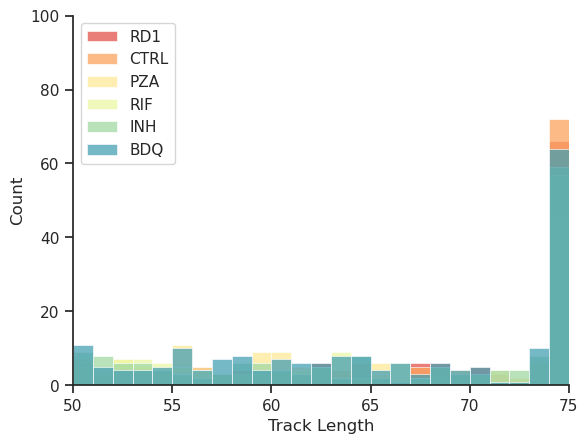

In [294]:
for n, col in enumerate(df.iteritems()):
    if '3' in col[0][1]:
        info = assay_layout.loc[eval(col[0])]
        if 'RD1' in info['Strain']:
            label = 'RD1'
        else:
            label = info['Compound']
        sns.histplot(df[col[0]], binwidth=1, alpha = 0.75, label = label, color=colours[n])#kde = True)
plt.xlabel('Track Length')
plt.xlim(50, 75)
plt.ylim(0,100)
plt.legend()
sns.despine(offset=0) 

/tmp/ipykernel_104033/2194959599.py:1: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for n, col in enumerate(df.iteritems()):


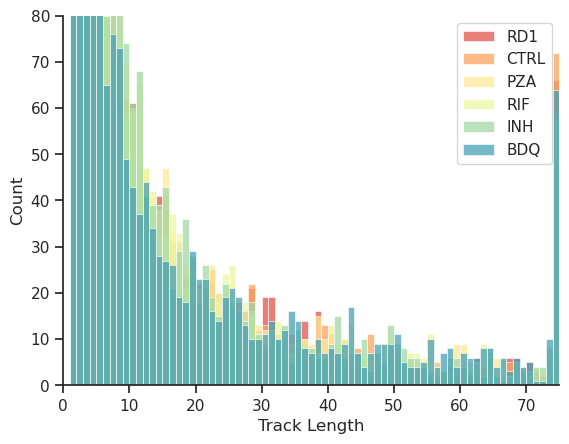

In [293]:
for n, col in enumerate(df.iteritems()):
    if '3' in col[0][1]:
        info = assay_layout.loc[eval(col[0])]
        if 'RD1' in info['Strain']:
            label = 'RD1'
        else:
            label = info['Compound']
        sns.histplot(df[col[0]], binwidth=1, alpha = 0.75, label = label, color=colours[n])#kde = True)
plt.xlabel('Track Length')
plt.xlim(0, 75)
plt.ylim(0,80)
plt.legend()
sns.despine(offset=0) 

In [83]:
row, column

(3, 9)

# Overlapping densities

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

In [ ]:
info = assay_layout.loc[eval(col[0])]

In [338]:
for row in df3.iterrows():
    info = assay_layout.loc[eval(row[0])]
    for key in info.keys():
        df3.at[row[0], key] = info[key]

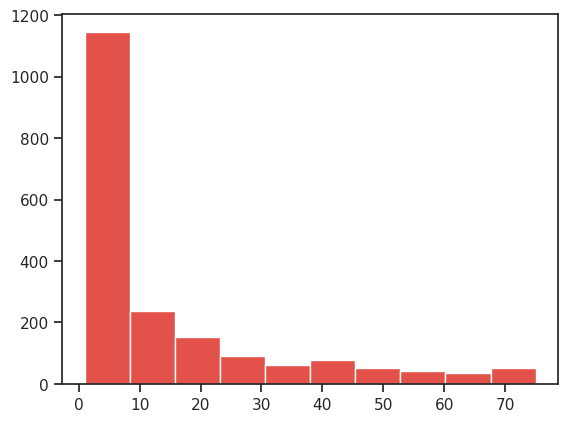

In [361]:
test = plt.hist(df[col[0]])

In [362]:
test

(array([1146.,  236.,  151.,   89.,   61.,   76.,   53.,   43.,   35.,
          51.]),
 array([ 1. ,  8.4, 15.8, 23.2, 30.6, 38. , 45.4, 52.8, 60.2, 67.6, 75. ]),
 <BarContainer object of 10 artists>)

In [365]:
df4 = pd.DataFrame(columns=['Strain', 'Compound', 'Concentration', 'Number of fully tracked cells'])

In [367]:
info = assay_layout.loc[eval(col[0])]

('(3, 4)',
 0                  18.0
 1                   1.0
 2                  28.0
 3                   4.0
 4                   1.0
                    ... 
 2798                NaN
 Strain              RD1
 Compound           CTRL
 Concentration         0
 ConcentrationEC     EC0
 Name: (3, 4), Length: 2803, dtype: object)

In [377]:
len([r for r in row[1] if r == 75])

54

In [381]:
for n, row in enumerate(df3.iterrows()):
    info = assay_layout.loc[eval(row[0])]
    df4.at[n, 'Strain'] = info['Strain']
    df4.at[n, 'Compound'] = info['Compound']
    df4.at[n, 'Concentration'] = info['Concentration']
    number = len([r for r in row[1] if r == 75])
    df4.at[n, 'Number of fully tracked cells'] = number

In [382]:

df4

,Strain,Compound,Concentration,Number of fully tracked cells
0,RD1,CTRL,0,54
1,WT,CTRL,0,64
2,WT,PZA,60,38
3,WT,RIF,0.1,46
4,WT,INH,0.04,45
5,WT,BDQ,0.02,54
6,RD1,CTRL,0,49
7,WT,CTRL,0,65
8,WT,PZA,60,46
9,WT,RIF,0.1,52


# Small multiple time series

In [392]:
tracks_df = pd.DataFrame(columns = ['Time', 'Intracellular Mtb content', 'Strain', 'Compound', 'Concentration'])

In [393]:
tracks_df

,Time,Intracellular Mtb content,Strain,Compound,Concentration


In [421]:
track

,ID,t,x,y,z,parent,root,state,generation,dummy,orientation,minor_axis_length,major_axis_length,mean_intensity-1,area,mean_intensity-0
0,343,0,1169.847412,13.893421,0.000000,343,343,5,0,False,0.973446,23.934866,40.768143,0.005136,760.0,0.014705
1,343,1,1172.826538,14.674929,0.000000,343,343,5,0,False,1.071109,26.991920,50.315022,0.005121,1049.0,0.013235
2,343,2,1174.588867,14.375803,0.000000,343,343,5,0,False,1.102848,28.892620,41.603973,0.005116,934.0,0.013899
3,343,3,1175.250610,12.160207,0.000000,343,343,5,0,False,1.179610,25.876078,38.452492,0.005094,774.0,0.013428
4,343,4,1180.553955,9.897770,0.000000,343,343,5,0,False,1.249804,21.138905,32.601627,0.005071,538.0,0.012774
5,343,5,1182.660522,13.432466,0.000000,343,343,5,0,False,-1.360878,31.543139,33.154293,0.005076,807.0,0.011567
6,343,6,1182.199341,14.609031,0.000000,343,343,5,0,False,-0.421803,34.129887,34.743092,0.005074,908.0,0.011940
7,343,7,1183.454224,14.055484,0.000000,343,343,5,0,False,-0.770454,28.738520,34.829750,0.005082,775.0,0.012868
8,343,8,1182.696045,15.890346,0.000000,343,343,5,0,False,-0.675068,28.664497,37.930733,0.005075,839.0,0.011705
9,343,9,1182.140869,13.777465,0.000000,343,343,5,0,False,-0.747762,25.986179,35.334423,0.005102,710.0,0.016224


In [9]:
dfs = list()
filtered_tracks = dict()
for key in tracks_dict.keys():
    filtered_tracks[key] = [track for track in tracks_dict[key] if len(track) == 75]
    for track in filtered_tracks[key]:
        info = assay_layout.loc[key]
        strain = info['Strain']
        comp = info['Compound']
        conc = info['ConcentrationEC']
        d = {'Time':track['t'], 'Area':track['area'], 
     'Intracellular Mtb content':track['mean_intensity-1'],
     'Macroph. GFP expression':track['mean_intensity-0'],
     'Eccentricity':np.sqrt(1-((track['minor_axis_length']**2)/(track['major_axis_length']**2))),
     'Strain':[strain for i in range(len(track['t']))], 
     'Compound':[comp for i in range(len(track['t']))], 
     'Concentration':[conc for i in range(len(track['t']))], 
     'Cell ID':[track.ID for i in range(len(track['t']))],
     'Acquisition ID':[key for i in range(len(track['t']))]}
        dfs.append(pd.DataFrame(d))
df = pd.concat(dfs, ignore_index=True)

In [10]:
df

,Time,Area,Intracellular Mtb content,Macroph. GFP expression,Eccentricity,Strain,Compound,Concentration,Cell ID,Acquisition ID
0,0,760.0,0.005136,0.014705,0.809516,RD1,CTRL,EC0,343,"(3, 4)"
1,1,1049.0,0.005121,0.013235,0.843927,RD1,CTRL,EC0,343,"(3, 4)"
2,2,934.0,0.005116,0.013899,0.719524,RD1,CTRL,EC0,343,"(3, 4)"
3,3,774.0,0.005094,0.013428,0.739700,RD1,CTRL,EC0,343,"(3, 4)"
4,4,538.0,0.005071,0.012774,0.761300,RD1,CTRL,EC0,343,"(3, 4)"
...,...,...,...,...,...,...,...,...,...,...
81520,70,3018.0,0.005635,0.024949,0.698306,WT,BDQ,EC99,155,"(6, 9)"
81521,71,2863.0,0.005609,0.024090,0.716728,WT,BDQ,EC99,155,"(6, 9)"
81522,72,3047.0,0.005600,0.022092,0.789115,WT,BDQ,EC99,155,"(6, 9)"
81523,73,2737.0,0.005606,0.021206,0.822009,WT,BDQ,EC99,155,"(6, 9)"


In [465]:
sns.set_theme(style="ticks")
# palette = sns.color_palette("Spectral", n_colors=2)
sns.set_palette("rocket_r")

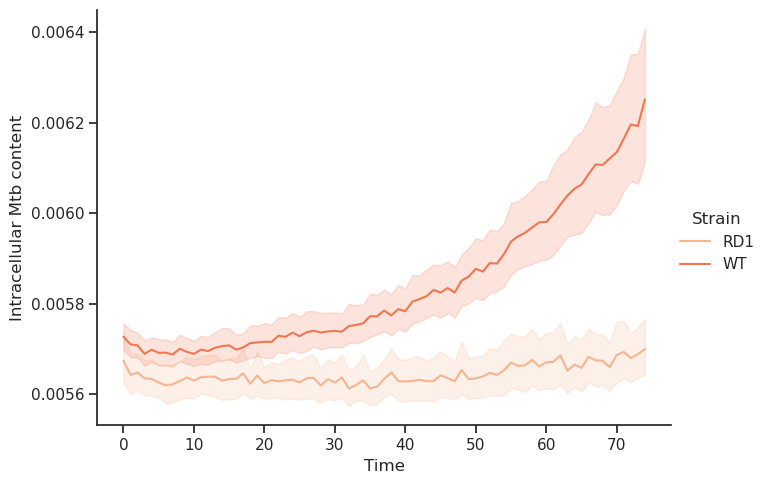

In [466]:
sns.relplot(data = df, 
            x = 'Time', 
            y = 'Intracellular Mtb content', 
            hue = 'Strain', kind = 'line', 
            aspect = 1.4,# palette = palette
           )

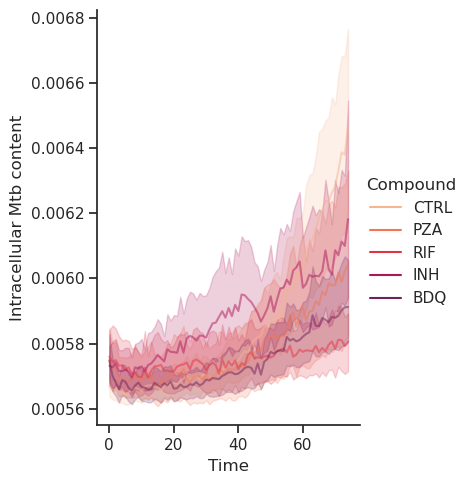

In [477]:
sns.relplot(data = df, 
            x = 'Time', 
            y = 'Intracellular Mtb content', 
            hue = 'Compound', kind = 'line', 
            aspect = 0.8, alpha = 0.5
           )

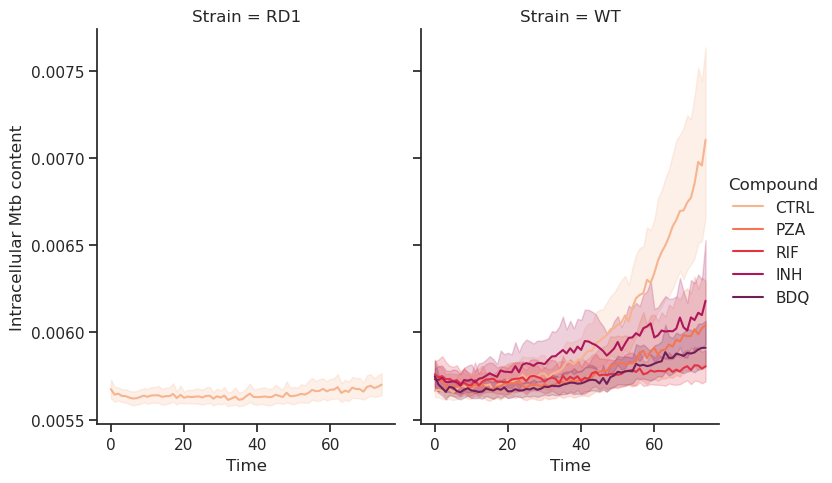

In [474]:
# Plot the lines on two facets
sns.relplot(
    data=df,
    x = 'Time', 
    y = 'Intracellular Mtb content', 
    hue="Compound",# size="Area", 
    col="Strain",
    kind="line", #size_order=["T1", "T2"], palette=palette,
    height=5, aspect=.75, facet_kws=dict(sharex=False),
)

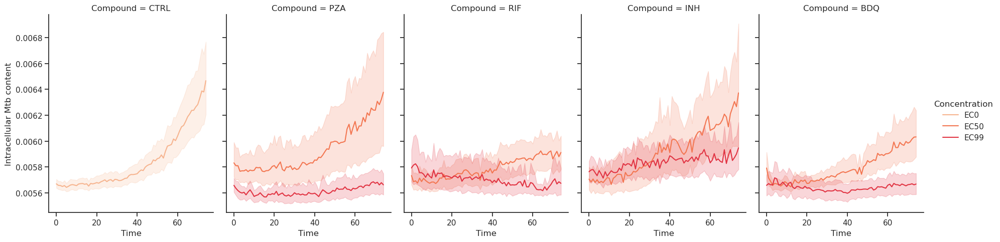

In [479]:
# Plot the lines on two facets
sns.relplot(
    data=df,
    x = 'Time', 
    y = 'Intracellular Mtb content', 
#     hue="",# size="Area", 
    col="Compound",
    hue = 'Concentration',
    kind="line", #size_order=["T1", "T2"], palette=palette,
    height=5, aspect=.75, facet_kws=dict(sharex=False),
)

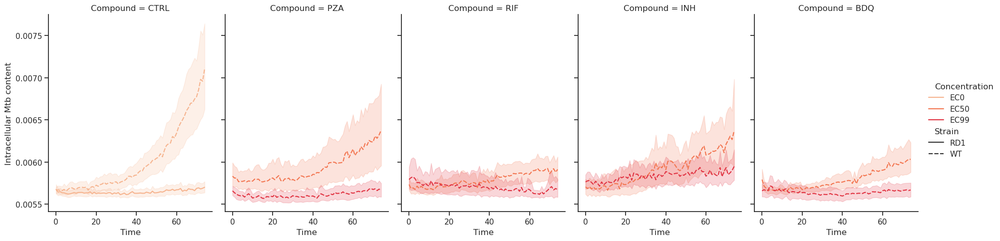

In [485]:
# Plot the lines on two facets
sns.relplot(
    data=df,
    x = 'Time', 
    y = 'Intracellular Mtb content', 
#     hue="",# size="Area", 
    col="Compound",
    hue = 'Concentration',
    kind="line", 
    style = 'Strain',#size_order=["T1", "T2"], palette=palette,
    height=5, aspect=.75, facet_kws=dict(sharex=False),
)
plt.savefig('test.png', dpi = 314)

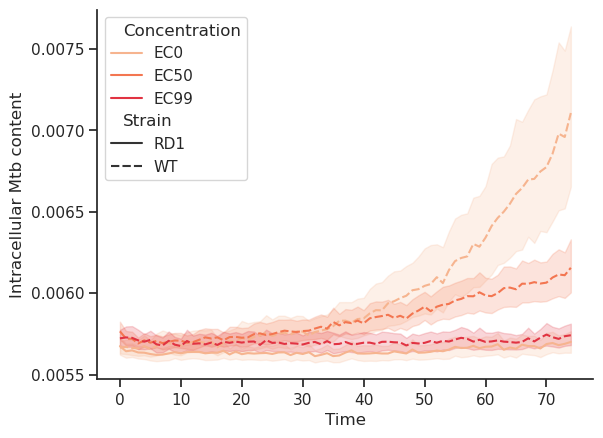

In [482]:
sns.lineplot( data=df,
                x = 'Time', 
                y = 'Intracellular Mtb content', 
                 hue = 'Concentration',
             style="Strain",)
sns.despine()

In [505]:
sns.color_palette("rocket", n_colors=5)

[(0.24525608, 0.10497384, 0.26395596),
 (0.51728314, 0.1179558, 0.35453252),
 (0.7965014, 0.10506637, 0.31063031),
 (0.94291042, 0.37549479, 0.26369821),
 (0.96443322, 0.67025402, 0.51509334)]

In [497]:
palette

[(0.94291042, 0.37549479, 0.26369821), (0.51728314, 0.1179558, 0.35453252)]

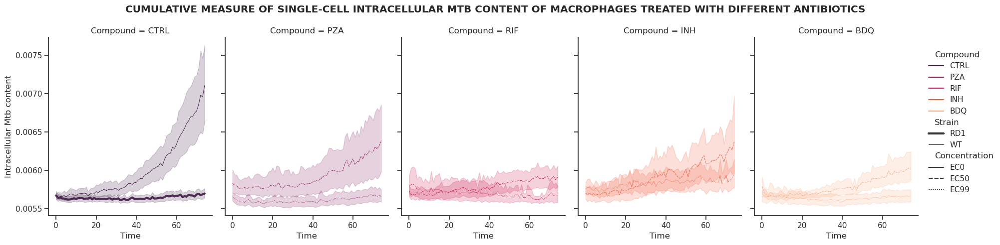

In [542]:
# sns.set_palette("PiYG")
palette = sns.color_palette("rocket", n_colors=5)

# Plot the lines on two facets
rel = sns.relplot(
    data=df,
    x = 'Time', 
    y = 'Intracellular Mtb content', 
#     hue="",
    size="Strain", 
    col="Compound",
    hue = 'Compound',
    kind="line", 
    style = 'Concentration',#size_order=["T1", "T2"], 
    palette=palette,
    height=5, aspect=.75, facet_kws=dict(sharex=False),
    alpha = 0.9
)
rel.fig.subplots_adjust(top=.85)
rel.fig.suptitle('CUMULATIVE MEASURE OF SINGLE-CELL INTRACELLULAR MTB CONTENT OF MACROPHAGES TREATED WITH DIFFERENT ANTIBIOTICS',weight='bold')
plt.savefig('/mnt/DATA/macrohet/results/preliminary_sc_measures/strain_compound_compound_concentration.png', dpi = 314)


In [486]:
df.to_pickle('/mnt/DATA/macrohet/results/preliminary_sc_measures/longest_track_Mtb.pkl')  # where to save it, usually as a .pkl

#### Fitler control out

In [537]:
df.loc[df['Concentration'] != 'EC0']

,Time,Area,Intracellular Mtb content,Strain,Compound,Concentration
8850,0,1524.0,0.005643,WT,PZA,EC50
8851,1,746.0,0.005637,WT,PZA,EC50
8852,2,700.0,0.005688,WT,PZA,EC50
8853,3,642.0,0.005684,WT,PZA,EC50
8854,4,953.0,0.005651,WT,PZA,EC50
...,...,...,...,...,...,...
81520,70,3018.0,0.005635,WT,BDQ,EC99
81521,71,2863.0,0.005609,WT,BDQ,EC99
81522,72,3047.0,0.005600,WT,BDQ,EC99
81523,73,2737.0,0.005606,WT,BDQ,EC99


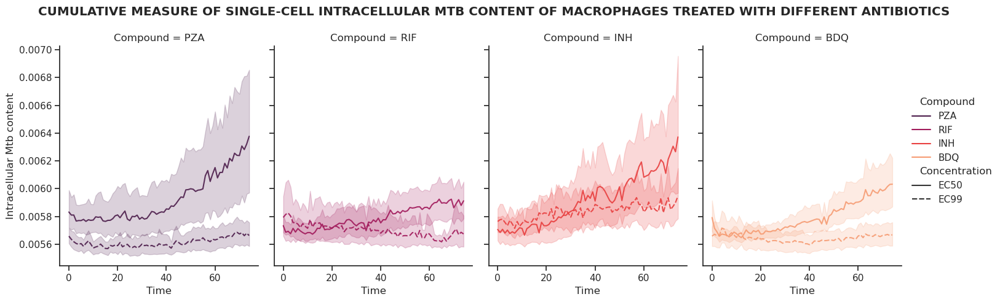

In [541]:
# sns.set_palette("PiYG")
palette = sns.color_palette("rocket", n_colors=4)

# Plot the lines on two facets
rel = sns.relplot(
    data=df.loc[df['Concentration'] != 'EC0'],
    x = 'Time', 
    y = 'Intracellular Mtb content', 
#     hue="",
    #size="Strain", 
    col="Compound",
    hue = 'Compound',
    kind="line", 
    style = 'Concentration',#size_order=["T1", "T2"], 
    palette=palette,
    height=5, aspect=.75, facet_kws=dict(sharex=False),
    alpha = 0.9
)
rel.fig.subplots_adjust(top=.85)
rel.fig.suptitle('CUMULATIVE MEASURE OF SINGLE-CELL INTRACELLULAR MTB CONTENT OF MACROPHAGES TREATED WITH DIFFERENT ANTIBIOTICS',weight='bold')
plt.savefig('/mnt/DATA/macrohet/results/preliminary_sc_measures/nocontrol_strain_compound_compound_concentration.png', dpi = 314)


# making glimpses

What do I want to show? A) tracking efficacy and B) single-cell heterogeneity

In [546]:
max(df['Area']), min(df['Area'])

(16774.0, 501.0)

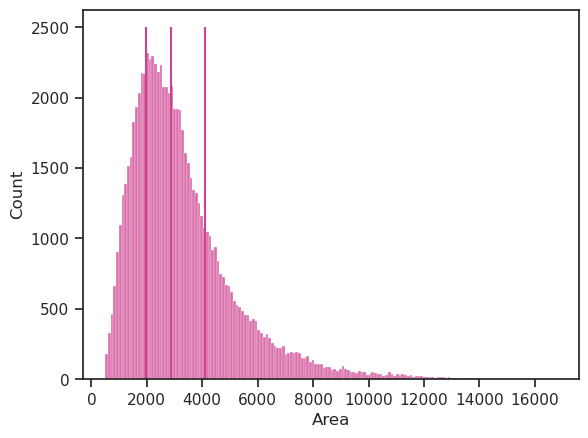

In [579]:
sns.histplot(df['Area'])
plt.vlines([df['Area'].quantile(.25), df['Area'].quantile(0.5), df['Area'].quantile(.75)], ymin = 0, ymax = 2500)

### Discretising area and eccentricity into categorical groups for plotting

In [576]:
df['Area'].quantile(.25), df['Area'].quantile(0.5), df['Area'].quantile(.75)

(1979.0, 2862.0, 4094.75)

In [582]:
df['Area'].quantile(.0)

16774.0

In [588]:
area_quartiles = pd.cut(df['Area'], bins = [df['Area'].quantile(.0), 
                                    df['Area'].quantile(.25), 
                                    df['Area'].quantile(0.5), 
                                    df['Area'].quantile(.75),
                                    df['Area'].quantile(1)], 
                                    labels = ['Lower', 'Lower-mid', 'Upper-mid', 'Upper'])
area_quartiles

0            Lower
1            Lower
2            Lower
3            Lower
4            Lower
           ...    
81520    Upper-mid
81521    Upper-mid
81522    Upper-mid
81523    Lower-mid
81524    Lower-mid
Name: Area, Length: 81525, dtype: category
Categories (4, object): ['Lower' < 'Lower-mid' < 'Upper-mid' < 'Upper']

In [589]:
df['Area quartiles'] = area_quartiles

In [590]:
df

,Time,Area,Intracellular Mtb content,Macroph. GFP expression,Eccentricity,Strain,Compound,Concentration,Cell ID,Acquisition ID,Area quartiles
0,0,760.0,0.005136,0.014705,0.809516,RD1,CTRL,EC0,343,"(3, 4)",Lower
1,1,1049.0,0.005121,0.013235,0.843927,RD1,CTRL,EC0,343,"(3, 4)",Lower
2,2,934.0,0.005116,0.013899,0.719524,RD1,CTRL,EC0,343,"(3, 4)",Lower
3,3,774.0,0.005094,0.013428,0.739700,RD1,CTRL,EC0,343,"(3, 4)",Lower
4,4,538.0,0.005071,0.012774,0.761300,RD1,CTRL,EC0,343,"(3, 4)",Lower
...,...,...,...,...,...,...,...,...,...,...,...
81520,70,3018.0,0.005635,0.024949,0.698306,WT,BDQ,EC99,155,"(6, 9)",Upper-mid
81521,71,2863.0,0.005609,0.024090,0.716728,WT,BDQ,EC99,155,"(6, 9)",Upper-mid
81522,72,3047.0,0.005600,0.022092,0.789115,WT,BDQ,EC99,155,"(6, 9)",Upper-mid
81523,73,2737.0,0.005606,0.021206,0.822009,WT,BDQ,EC99,155,"(6, 9)",Lower-mid


In [591]:
eccentricity_quartiles = pd.cut(df['Eccentricity'], bins = [df['Eccentricity'].quantile(.0), 
                                    df['Eccentricity'].quantile(.25), 
                                    df['Eccentricity'].quantile(0.5), 
                                    df['Eccentricity'].quantile(.75),
                                    df['Eccentricity'].quantile(1)], 
                                    labels = ['Lower', 'Lower-mid', 'Upper-mid', 'Upper'])
eccentricity_quartiles

0        Lower-mid
1        Upper-mid
2        Lower-mid
3        Lower-mid
4        Lower-mid
           ...    
81520    Lower-mid
81521    Lower-mid
81522    Lower-mid
81523    Upper-mid
81524    Upper-mid
Name: Eccentricity, Length: 81525, dtype: category
Categories (4, object): ['Lower' < 'Lower-mid' < 'Upper-mid' < 'Upper']

In [592]:
df['Eccentricity quartiles'] = eccentricity_quartiles

In [616]:
df['Total Mtb content'] = df['Intracellular Mtb content']*df['Area']

# Plotting quartile morphology groupings

Text(0.5, 0.98, 'CUMULATIVE MEASURE OF SINGLE-CELL INTRACELLULAR MTB CONTENT OF MACROPHAGES TREATED WITH DIFFERENT ANTIBIOTICS')

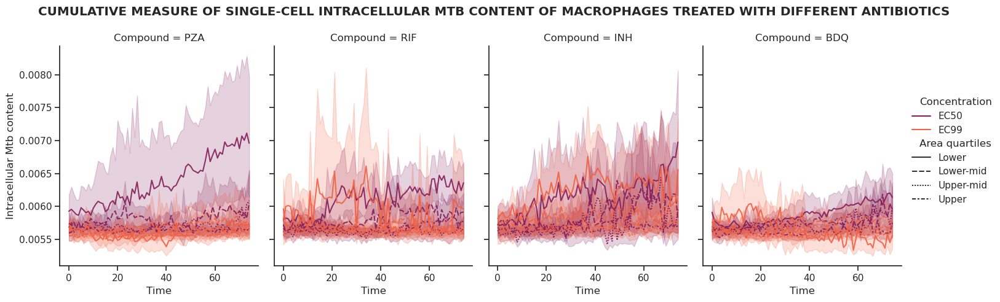

In [621]:
# sns.set_palette("PiYG")
palette = sns.color_palette("rocket", n_colors=2)

# Plot the lines on two facets
rel = sns.relplot(
    data=df.loc[df['Concentration'] != 'EC0'],
    x = 'Time', 
    y = 'Intracellular Mtb content', 
#     hue="",
    #size="Strain", 
    col="Compound",
    hue = 'Concentration',
    kind="line", 
    style = 'Area quartiles',#size_order=["T1", "T2"], 
    palette=palette,
    height=5, aspect=.75, facet_kws=dict(sharex=False),
    alpha = 0.9
)
rel.fig.subplots_adjust(top=.85)
rel.fig.suptitle('CUMULATIVE MEASURE OF SINGLE-CELL INTRACELLULAR MTB CONTENT OF MACROPHAGES TREATED WITH DIFFERENT ANTIBIOTICS',weight='bold')
# plt.savefig('/mnt/DATA/macrohet/results/preliminary_sc_measures/nocontrol_strain_compound_compound_concentration.png', dpi = 314)


Text(0.5, 0.98, 'CUMULATIVE MEASURE OF SINGLE-CELL INTRACELLULAR MTB CONTENT OF MACROPHAGES TREATED WITH DIFFERENT ANTIBIOTICS')

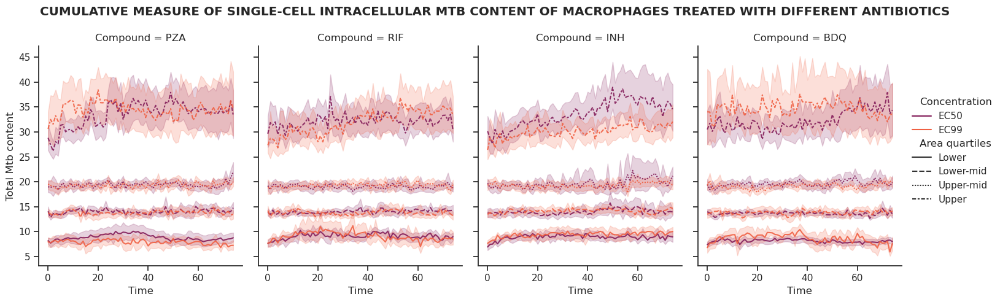

In [620]:
# sns.set_palette("PiYG")
palette = sns.color_palette("rocket", n_colors=2)

# Plot the lines on two facets
rel = sns.relplot(
    data=df.loc[df['Concentration'] != 'EC0'],
    x = 'Time', 
    y = 'Total Mtb content', 
#     hue="",
    #size="Strain", 
    col="Compound",
    hue = 'Concentration',
    kind="line", 
    style = 'Area quartiles',#size_order=["T1", "T2"], 
    palette=palette,
    height=5, aspect=.75, facet_kws=dict(sharex=False),
    alpha = 0.9
)
rel.fig.subplots_adjust(top=.85)
rel.fig.suptitle('CUMULATIVE MEASURE OF SINGLE-CELL INTRACELLULAR MTB CONTENT OF MACROPHAGES TREATED WITH DIFFERENT ANTIBIOTICS',weight='bold')
# plt.savefig('/mnt/DATA/macrohet/results/preliminary_sc_measures/nocontrol_strain_compound_compound_concentration.png', dpi = 314)


Text(0.5, 0.98, 'CUMULATIVE MEASURE OF SINGLE-CELL INTRACELLULAR MTB CONTENT OF MACROPHAGES TREATED WITH DIFFERENT ANTIBIOTICS')

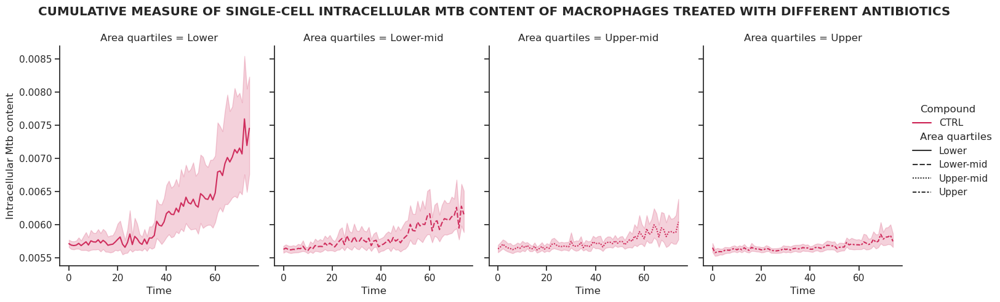

In [619]:

# sns.set_palette("PiYG")
palette = sns.color_palette("rocket", n_colors=1)

# Plot the lines on two facets
rel = sns.relplot(
    data=df.loc[df['Concentration'] == 'EC0'],
    x = 'Time', 
    y = 'Intracellular Mtb content', 
#     hue="",
    #size="Strain", 
    col="Area quartiles",
    hue = 'Compound',
    kind="line", 
    style = 'Area quartiles',#size_order=["T1", "T2"], 
    palette=palette,
    height=5, aspect=.75, facet_kws=dict(sharex=False),
    alpha = 0.9
)
rel.fig.subplots_adjust(top=.85)
rel.fig.suptitle('CUMULATIVE MEASURE OF SINGLE-CELL INTRACELLULAR MTB CONTENT OF MACROPHAGES TREATED WITH DIFFERENT ANTIBIOTICS',weight='bold')
# plt.savefig('/mnt/DATA/macrohet/results/preliminary_sc_measures/nocontrol_strain_compound_compound_concentration.png', dpi = 314)


Text(0.5, 0.98, 'CUMULATIVE MEASURE OF SINGLE-CELL INTRACELLULAR MTB CONTENT OF MACROPHAGES TREATED WITH DIFFERENT ANTIBIOTICS')

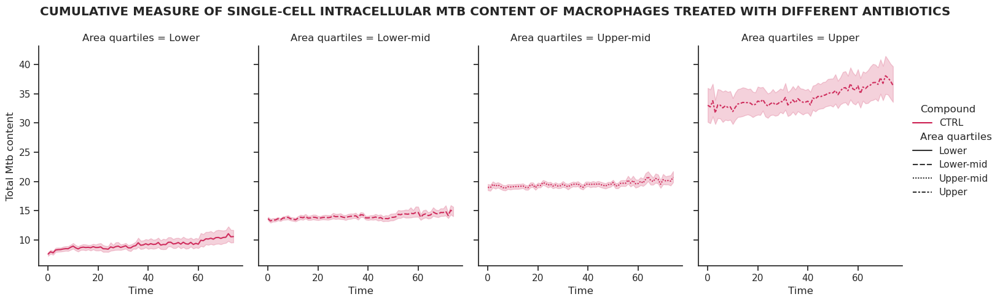

In [618]:

# sns.set_palette("PiYG")
palette = sns.color_palette("rocket", n_colors=1)

# Plot the lines on two facets
rel = sns.relplot(
    data=df.loc[df['Concentration'] == 'EC0'],
    x = 'Time', 
    y = 'Total Mtb content', 
#     hue="",
    #size="Strain", 
    col="Area quartiles",
    hue = 'Compound',
    kind="line", 
    style = 'Area quartiles',#size_order=["T1", "T2"], 
    palette=palette,
    height=5, aspect=.75, facet_kws=dict(sharex=False),
    alpha = 0.9
)
rel.fig.subplots_adjust(top=.85)
rel.fig.suptitle('CUMULATIVE MEASURE OF SINGLE-CELL INTRACELLULAR MTB CONTENT OF MACROPHAGES TREATED WITH DIFFERENT ANTIBIOTICS',weight='bold')
# plt.savefig('/mnt/DATA/macrohet/results/preliminary_sc_measures/nocontrol_strain_compound_compound_concentration.png', dpi = 314)


Text(0.5, 0.98, 'CUMULATIVE MEASURE OF SINGLE-CELL INTRACELLULAR MTB CONTENT OF MACROPHAGES TREATED WITH DIFFERENT ANTIBIOTICS')

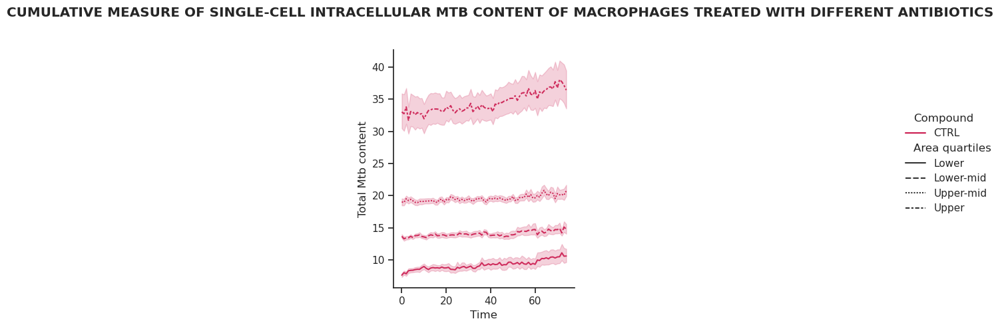

In [622]:

# sns.set_palette("PiYG")
palette = sns.color_palette("rocket", n_colors=1)

# Plot the lines on two facets
rel = sns.relplot(
    data=df.loc[df['Concentration'] == 'EC0'],
    x = 'Time', 
    y = 'Total Mtb content', 
#     hue="",
    #size="Strain", 
    #col="Area quartiles",
    hue = 'Compound',
    kind="line", 
    style = 'Area quartiles',#size_order=["T1", "T2"], 
    palette=palette,
    height=5, aspect=.75, facet_kws=dict(sharex=False),
    alpha = 0.9
)
rel.fig.subplots_adjust(top=.85)
rel.fig.suptitle('CUMULATIVE MEASURE OF SINGLE-CELL INTRACELLULAR MTB CONTENT OF MACROPHAGES TREATED WITH DIFFERENT ANTIBIOTICS',weight='bold')
# plt.savefig('/mnt/DATA/macrohet/results/preliminary_sc_measures/nocontrol_strain_compound_compound_concentration.png', dpi = 314)


Text(0.5, 0.98, 'CUMULATIVE MEASURE OF SINGLE-CELL INTRACELLULAR MTB CONTENT OF MACROPHAGES TREATED WITH DIFFERENT ANTIBIOTICS')

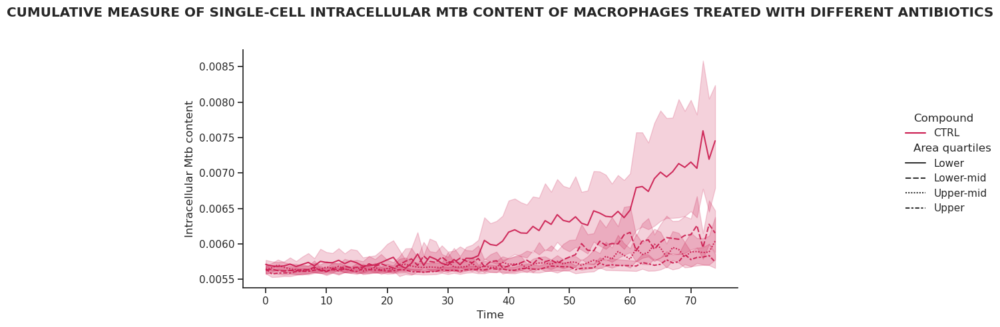

In [624]:

# sns.set_palette("PiYG")
palette = sns.color_palette("rocket", n_colors=1)

# Plot the lines on two facets
rel = sns.relplot(
    data=df.loc[df['Concentration'] == 'EC0'],
    x = 'Time', 
    y = 'Intracellular Mtb content', 
#     hue="",
    #size="Strain", 
    #col="Area quartiles",
    hue = 'Compound',
    kind="line", 
    style = 'Area quartiles',#size_order=["T1", "T2"], 
    palette=palette,
    height=5, aspect=1.75, facet_kws=dict(sharex=False),
    alpha = 0.9
)
rel.fig.subplots_adjust(top=.85)
rel.fig.suptitle('CUMULATIVE MEASURE OF SINGLE-CELL INTRACELLULAR MTB CONTENT OF MACROPHAGES TREATED WITH DIFFERENT ANTIBIOTICS',weight='bold')
# plt.savefig('/mnt/DATA/macrohet/results/preliminary_sc_measures/nocontrol_strain_compound_compound_concentration.png', dpi = 314)


Text(0.5, 0.98, 'CUMULATIVE MEASURE OF SINGLE-CELL INTRACELLULAR MTB CONTENT OF MACROPHAGES TREATED WITH DIFFERENT ANTIBIOTICS')

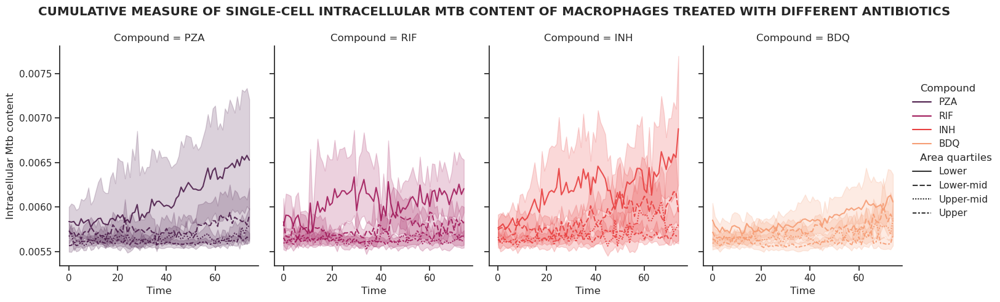

In [629]:

# sns.set_palette("PiYG")
palette = sns.color_palette("rocket", n_colors=4)

# Plot the lines on two facets
rel = sns.relplot(
    data=df.loc[df['Concentration'] != 'EC0'],
    x = 'Time', 
    y = 'Intracellular Mtb content', 
#     hue="",
    #size="Strain", 
    col="Compound",
    hue = 'Compound',
    kind="line", 
    style = 'Area quartiles',#size_order=["T1", "T2"], 
    palette=palette,
    height=5, aspect=0.75, facet_kws=dict(sharex=False),
    alpha = 0.9
)
rel.fig.subplots_adjust(top=.85)
rel.fig.suptitle('CUMULATIVE MEASURE OF SINGLE-CELL INTRACELLULAR MTB CONTENT OF MACROPHAGES TREATED WITH DIFFERENT ANTIBIOTICS',weight='bold')
# plt.savefig('/mnt/DATA/macrohet/results/preliminary_sc_measures/nocontrol_strain_compound_compound_concentration.png', dpi = 314)


Text(0.5, 0.98, 'CUMULATIVE MEASURE OF SINGLE-CELL INTRACELLULAR MTB CONTENT OF MACROPHAGES TREATED WITH DIFFERENT ANTIBIOTICS')

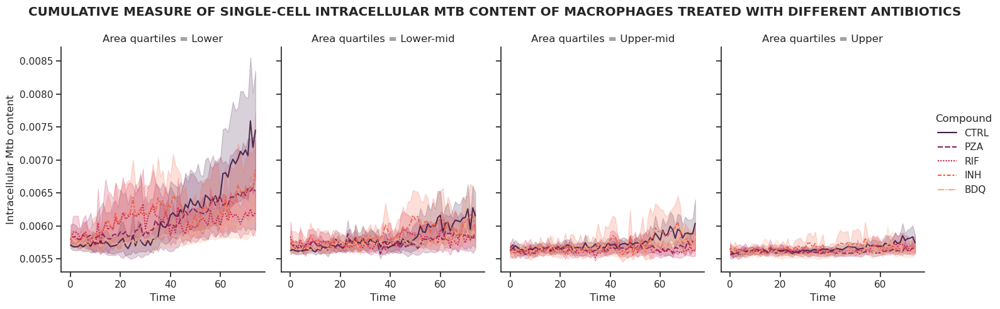

In [614]:

# sns.set_palette("PiYG")
palette = sns.color_palette("rocket", n_colors=5)

# Plot the lines on two facets
rel = sns.relplot(
    data=df,#.loc[df['Concentration'] == 'EC0'],
    x = 'Time', 
    y = 'Intracellular Mtb content', 
#     hue="",
    #size="Strain", 
    col="Area quartiles",
    hue = 'Compound',
    kind="line", 
    style = 'Compound',#size_order=["T1", "T2"], 
    palette=palette,
    height=5, aspect=.75, facet_kws=dict(sharex=False),
    alpha = 0.9
)
rel.fig.subplots_adjust(top=.85)
rel.fig.suptitle('CUMULATIVE MEASURE OF SINGLE-CELL INTRACELLULAR MTB CONTENT OF MACROPHAGES TREATED WITH DIFFERENT ANTIBIOTICS',weight='bold')
# plt.savefig('/mnt/DATA/macrohet/results/preliminary_sc_measures/nocontrol_strain_compound_compound_concentration.png', dpi = 314)


Text(0.5, 0.98, 'CUMULATIVE MEASURE OF SINGLE-CELL INTRACELLULAR MTB CONTENT OF MACROPHAGES TREATED WITH DIFFERENT ANTIBIOTICS')

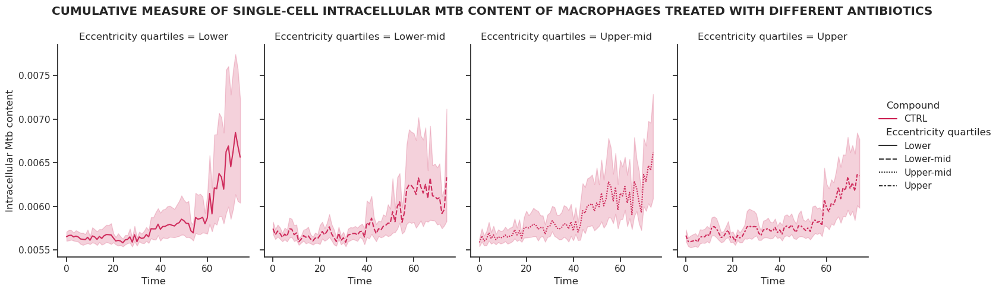

In [611]:

# sns.set_palette("PiYG")
palette = sns.color_palette("rocket", n_colors=1)

# Plot the lines on two facets
rel = sns.relplot(
    data=df.loc[df['Concentration'] == 'EC0'],
    x = 'Time', 
    y = 'Intracellular Mtb content', 
#     hue="",
    #size="Strain", 
    col="Eccentricity quartiles",
    hue = 'Compound',
    kind="line", 
    style = 'Eccentricity quartiles',#size_order=["T1", "T2"], 
    palette=palette,
    height=5, aspect=.75, facet_kws=dict(sharex=False),
    alpha = 0.9
)
rel.fig.subplots_adjust(top=.85)
rel.fig.suptitle('CUMULATIVE MEASURE OF SINGLE-CELL INTRACELLULAR MTB CONTENT OF MACROPHAGES TREATED WITH DIFFERENT ANTIBIOTICS',weight='bold')
# plt.savefig('/mnt/DATA/macrohet/results/preliminary_sc_measures/nocontrol_strain_compound_compound_concentration.png', dpi = 314)


Text(0.5, 0.98, 'CUMULATIVE MEASURE OF SINGLE-CELL INTRACELLULAR MTB CONTENT OF MACROPHAGES TREATED WITH DIFFERENT ANTIBIOTICS')

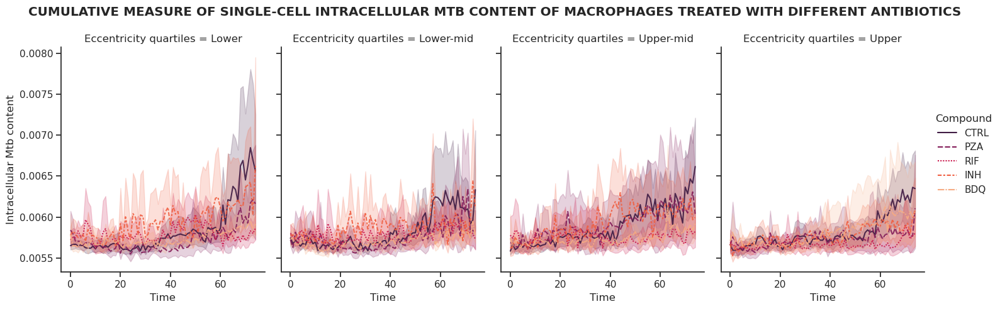

In [615]:

# sns.set_palette("PiYG")
palette = sns.color_palette("rocket", n_colors=5)

# Plot the lines on two facets
rel = sns.relplot(
    data=df,#.loc[df['Concentration'] == 'EC0'],
    x = 'Time', 
    y = 'Intracellular Mtb content', 
#     hue="",
    #size="Strain", 
    col="Eccentricity quartiles",
    hue = 'Compound',
    kind="line", 
    style = 'Compound',#size_order=["T1", "T2"], 
    palette=palette,
    height=5, aspect=.75, facet_kws=dict(sharex=False),
    alpha = 0.9
)
rel.fig.subplots_adjust(top=.85)
rel.fig.suptitle('CUMULATIVE MEASURE OF SINGLE-CELL INTRACELLULAR MTB CONTENT OF MACROPHAGES TREATED WITH DIFFERENT ANTIBIOTICS',weight='bold')
# plt.savefi

# Extracting other params

In [630]:
track

,ID,t,x,y,z,parent,root,state,generation,dummy,orientation,minor_axis_length,major_axis_length,mean_intensity-1,area,mean_intensity-0
0,155,0,555.648987,1179.639893,0.0,155,155,5,0,False,0.811600,27.485764,57.717491,0.005468,1094.0,0.013893
1,155,1,555.648987,1179.639893,0.0,155,155,5,0,True,NaN,NaN,NaN,NaN,NaN,NaN
2,155,2,554.156250,1165.431519,0.0,155,155,5,0,False,0.648059,38.810028,102.631187,0.005628,2688.0,0.018413
3,155,3,550.792236,1156.691528,0.0,155,155,5,0,False,0.530133,52.197090,101.140877,0.005608,4082.0,0.019690
4,155,4,548.738403,1153.119019,0.0,155,155,5,0,False,0.472595,53.929596,103.479881,0.005641,4301.0,0.022936
5,155,5,548.794983,1148.502563,0.0,155,155,5,0,False,0.371089,56.267254,106.584595,0.005620,4638.0,0.021255
6,155,6,551.285889,1146.918457,0.0,155,155,5,0,False,0.254512,55.822388,110.013023,0.005635,4712.0,0.021566
7,155,7,551.167114,1154.885742,0.0,155,155,5,0,False,0.516713,50.323452,96.223579,0.005583,3650.0,0.022895
8,155,8,557.882751,1142.200684,0.0,155,155,5,0,False,0.111489,64.365799,108.984268,0.005672,5221.0,0.023741
9,155,9,566.869202,1143.670044,0.0,155,155,5,0,False,-0.317293,62.962196,102.315086,0.005666,4724.0,0.022816


In [11]:
def msd_calc(x1, y1, x2, y2):
    return np.sqrt((x1-x2)**2+(y1-y2)**2)

In [654]:
for i in range(1, len(track)):
    x1, y1 = track['x'][i-1], track['y'][i-1]
    x2, y2 = track['x'][i], track['y'][i]
    df.at[i, 'MSD'] = msd_calc(x1,y1,x2,y2)
    print(msd_calc(x1, y1, x2, y2))
    break

0.0


[0,
 3.07992622385405,
 1.7875346233001037,
 2.312308485553916,
 5.76576845397335,
 4.114814613306541,
 1.2637223213920847,
 1.3715484131870799,
 1.9853343846924982,
 2.184601801061178,
 3.135121726875656,
 2.668881441389585,
 1.5503349238448159,
 3.9190469297274286,
 4.255541588986989,
 3.495357915677279,
 2.3629760829173487,
 5.405722692777534,
 14.17748902978051,
 5.439109872109729,
 5.130864521244539,
 4.84755450769558,
 4.156888362434027,
 2.6349760106683395,
 1.1307552506973626,
 1.7149064609205977,
 5.75239644827556,
 12.003070163657412,
 5.841007056777648,
 7.460589358061363,
 7.9911104506810124,
 9.185132971683583,
 2.7805168961151625,
 3.6910752067451944,
 15.903088314203687,
 7.380783975484491,
 12.19991547801287,
 12.1946505372064,
 5.349307134310256,
 9.735077842081507,
 4.762679249601671,
 6.87302300038074,
 7.565840063851094,
 5.236349334517328,
 5.857343007149334,
 2.0346333095911593,
 2.121402961202388,
 2.096421326006747,
 6.747517517311979,
 0.49599888788207225,
 3.1

# Adding more info to tracks

In [13]:
dfs = list()
filtered_tracks = dict()
for key in tracks_dict.keys():
    filtered_tracks[key] = [track for track in tracks_dict[key] if len(track) == 75]
    for track in filtered_tracks[key]:
        info = assay_layout.loc[key]
        strain = info['Strain']
        comp = info['Compound']
        conc = info['ConcentrationEC']
        d = {'Time':track['t'], 'Area':track['area'], 
     'Intracellular Mtb content':track['mean_intensity-1'],
     'Macroph. GFP expression':track['mean_intensity-0'],
     'Eccentricity':np.sqrt(1-((track['minor_axis_length']**2)/(track['major_axis_length']**2))),
     'MSD': [msd_calc(track['x'][i-1], track['y'][i-1], 
                      track['x'][i], track['y'][i]) 
               if i != 0 else 0
             for i in range(0, len(track))],
     'Strain':[strain for i in range(len(track['t']))], 
     'Compound':[comp for i in range(len(track['t']))], 
     'Concentration':[conc for i in range(len(track['t']))], 
     'Cell ID':[track.ID for i in range(len(track['t']))],
     'Acquisition ID':[key for i in range(len(track['t']))]}
        dfs.append(pd.DataFrame(d))
df = pd.concat(dfs, ignore_index=True)

,Time,Area,Intracellular Mtb content,Macroph. GFP expression,Eccentricity,MSD,Strain,Compound,Concentration,Cell ID,Acquisition ID
0,0,760.0,0.005136,0.014705,0.809516,0.000000,RD1,CTRL,EC0,343,"(3, 4)"
1,1,1049.0,0.005121,0.013235,0.843927,3.079926,RD1,CTRL,EC0,343,"(3, 4)"
2,2,934.0,0.005116,0.013899,0.719524,1.787535,RD1,CTRL,EC0,343,"(3, 4)"
3,3,774.0,0.005094,0.013428,0.739700,2.312308,RD1,CTRL,EC0,343,"(3, 4)"
4,4,538.0,0.005071,0.012774,0.761300,5.765768,RD1,CTRL,EC0,343,"(3, 4)"
...,...,...,...,...,...,...,...,...,...,...,...
81520,70,3018.0,0.005635,0.024949,0.698306,3.245095,WT,BDQ,EC99,155,"(6, 9)"
81521,71,2863.0,0.005609,0.024090,0.716728,3.322821,WT,BDQ,EC99,155,"(6, 9)"
81522,72,3047.0,0.005600,0.022092,0.789115,3.471255,WT,BDQ,EC99,155,"(6, 9)"
81523,73,2737.0,0.005606,0.021206,0.822009,5.485335,WT,BDQ,EC99,155,"(6, 9)"


<AxesSubplot:xlabel='MSD', ylabel='Count'>

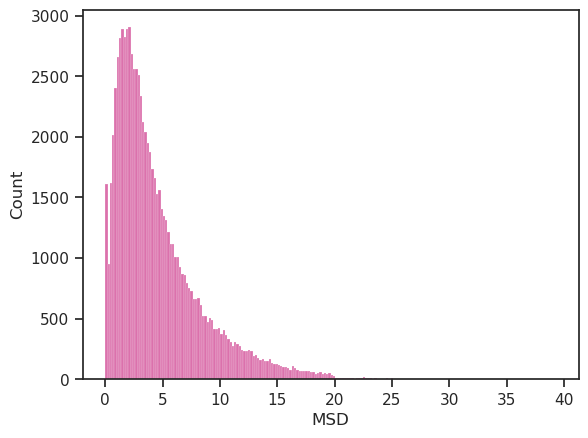

In [673]:
sns.histplot(df['MSD'])

In [14]:
msd_quartiles = pd.cut(df['MSD'], bins = [df['MSD'].quantile(.0), 
                                    df['MSD'].quantile(.25), 
                                    df['MSD'].quantile(0.5), 
                                    df['MSD'].quantile(.75),
                                    df['MSD'].quantile(1)], 
                                    labels = ['Lower', 'Lower-mid', 'Upper-mid', 'Upper'])
msd_quartiles

0              NaN
1        Lower-mid
2            Lower
3        Lower-mid
4        Upper-mid
           ...    
81520    Lower-mid
81521    Lower-mid
81522    Upper-mid
81523    Upper-mid
81524        Lower
Name: MSD, Length: 81525, dtype: category
Categories (4, object): ['Lower' < 'Lower-mid' < 'Upper-mid' < 'Upper']

In [15]:
df['MSD quartiles'] = msd_quartiles

Text(0.5, 0.98, 'CUMULATIVE MEASURE OF SINGLE-CELL INTRACELLULAR MTB CONTENT OF MACROPHAGES TREATED WITH DIFFERENT ANTIBIOTICS')

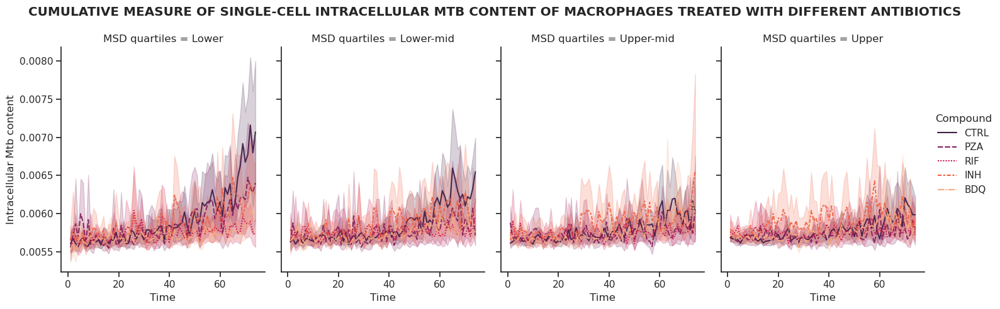

In [676]:
# sns.set_palette("PiYG")
palette = sns.color_palette("rocket", n_colors=5)

# Plot the lines on two facets
rel = sns.relplot(
    data=df,#.loc[df['Concentration'] == 'EC0'],
    x = 'Time', 
    y = 'Intracellular Mtb content', 
#     hue="",
    #size="Strain", 
    col="MSD quartiles",
    hue = 'Compound',
    kind="line", 
    style = 'Compound',#size_order=["T1", "T2"], 
    palette=palette,
    height=5, aspect=.75, facet_kws=dict(sharex=False),
    alpha = 0.9
)
rel.fig.subplots_adjust(top=.85)
rel.fig.suptitle('CUMULATIVE MEASURE OF SINGLE-CELL INTRACELLULAR MTB CONTENT OF MACROPHAGES TREATED WITH DIFFERENT ANTIBIOTICS',weight='bold')
# plt.savefi

Text(0.5, 0.98, 'CUMULATIVE MEASURE OF SINGLE-CELL INTRACELLULAR MTB CONTENT OF INFECTED MACROPHAGES')

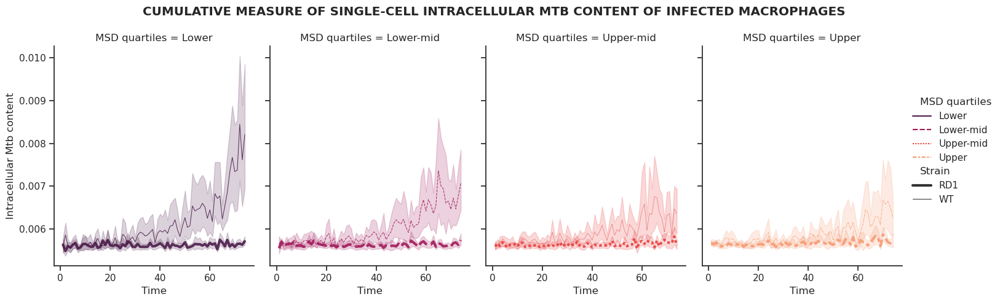

In [682]:
# sns.set_palette("PiYG")
palette = sns.color_palette("rocket", n_colors=4)

# Plot the lines on two facets
rel = sns.relplot(
    data=df.loc[df['Concentration'] == 'EC0'],
    x = 'Time', 
    y = 'Intracellular Mtb content', 
#     hue="",
    size="Strain", 
    col="MSD quartiles",
    hue = 'MSD quartiles',
    kind="line", 
    style = 'MSD quartiles',#size_order=["T1", "T2"], 
    palette=palette,
    height=5, aspect=.75, facet_kws=dict(sharex=False),
    alpha = 0.9
)
rel.fig.subplots_adjust(top=.85)
rel.fig.suptitle('CUMULATIVE MEASURE OF SINGLE-CELL INTRACELLULAR MTB CONTENT OF INFECTED MACROPHAGES',weight='bold')
# plt.savefi

Text(0.5, 0.98, 'CUMULATIVE MEASURE OF SINGLE-CELL INTRACELLULAR MTB CONTENT OF MACROPHAGES TREATED WITH DIFFERENT ANTIBIOTICS')

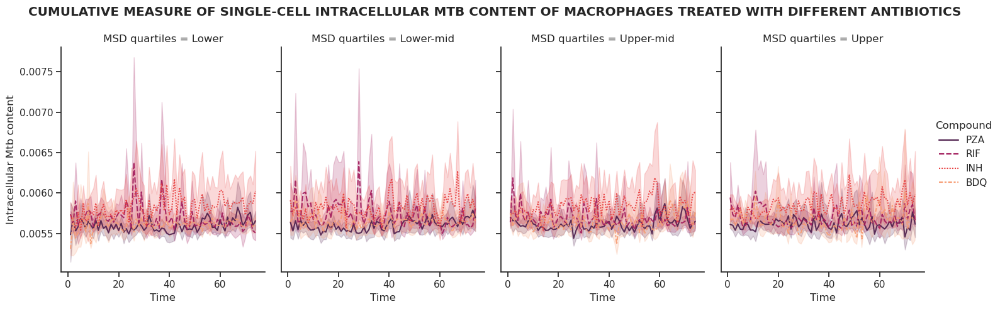

In [680]:
# sns.set_palette("PiYG")
palette = sns.color_palette("rocket", n_colors=4)

# Plot the lines on two facets
rel = sns.relplot(
    data=df.loc[df['Concentration'] == 'EC99'],
    x = 'Time', 
    y = 'Intracellular Mtb content', 
#     hue="",
    #size="Strain", 
    col="MSD quartiles",
    hue = 'Compound',
    kind="line", 
    style = 'Compound',#size_order=["T1", "T2"], 
    palette=palette,
    height=5, aspect=.75, facet_kws=dict(sharex=False),
    alpha = 0.9
)
rel.fig.subplots_adjust(top=.85)
rel.fig.suptitle('CUMULATIVE MEASURE OF SINGLE-CELL INTRACELLULAR MTB CONTENT OF MACROPHAGES TREATED WITH DIFFERENT ANTIBIOTICS',weight='bold')
# plt.savefi

In [954]:
palette[1]

(0.63139686, 0.10067417, 0.35664819)

Text(0.5, 0.98, 'CUMULATIVE MEASURE OF SINGLE-CELL INTRACELLULAR MTB CONTENT OF INFECTED MACROPHAGES')

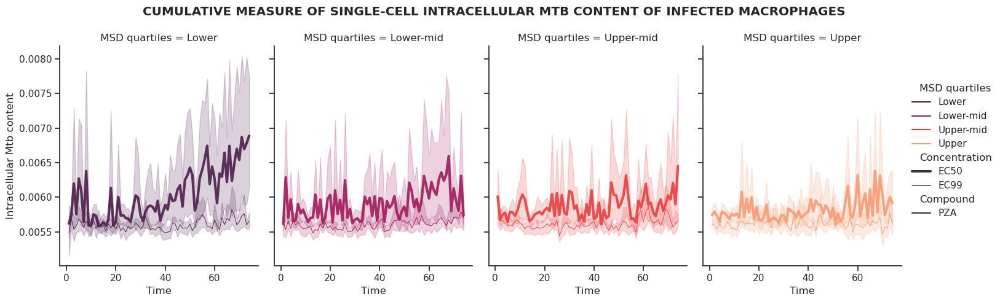

In [684]:
# sns.set_palette("PiYG")
palette = sns.color_palette("rocket", n_colors=4)

# Plot the lines on two facets
rel = sns.relplot(
    data=df.loc[df['Compound'] == 'PZA'],
    x = 'Time', 
    y = 'Intracellular Mtb content', 
    size="Concentration", 
    col="MSD quartiles",
    hue = 'MSD quartiles',
    kind="line", 
    style = 'Compound',#size_order=["T1", "T2"], 
    palette=palette,
    height=5, aspect=.75, facet_kws=dict(sharex=False),
    alpha = 0.9
)
rel.fig.subplots_adjust(top=.85)
rel.fig.suptitle('CUMULATIVE MEASURE OF SINGLE-CELL INTRACELLULAR MTB CONTENT OF INFECTED MACROPHAGES',weight='bold')


# Creating glimpses

In [16]:
dfs = list()
filtered_tracks = dict()
for key in tracks_dict.keys():
    filtered_tracks[key] = [track for track in tracks_dict[key] if len(track) == 75]
    for track in filtered_tracks[key]:
        info = assay_layout.loc[key]
        strain = info['Strain']
        comp = info['Compound']
        conc = info['ConcentrationEC']
        d = {'Time':track['t'], 'x':track['x'],
             'y':track['y'],'Area':track['area'], 
     'Intracellular Mtb content':track['mean_intensity-1'],
     'Macroph. GFP expression':track['mean_intensity-0'],
     'Eccentricity':np.sqrt(1-((track['minor_axis_length']**2)/(track['major_axis_length']**2))),
     'MSD': [msd_calc(track['x'][i-1], track['y'][i-1], 
                      track['x'][i], track['y'][i]) 
               if i != 0 else 0
             for i in range(0, len(track))],
     'Strain':[strain for i in range(len(track['t']))], 
     'Compound':[comp for i in range(len(track['t']))], 
     'Concentration':[conc for i in range(len(track['t']))], 
     'Cell ID':[track.ID for i in range(len(track['t']))],
     'Acquisition ID':[key for i in range(len(track['t']))]}
        dfs.append(pd.DataFrame(d))
df = pd.concat(dfs, ignore_index=True)

In [968]:
df.to_pickle('added_info_tracks.pkl')

In [688]:
assay_layout

Strain Compound Concentration ConcentrationEC
3 4    RD1     CTRL             0             EC0
  5     WT     CTRL             0             EC0
  6     WT      PZA            60            EC50
  7     WT      RIF           0.1            EC50
  8     WT      INH          0.04            EC50
  9     WT      BDQ          0.02            EC50
4 4    RD1     CTRL             0             EC0
  5     WT     CTRL             0             EC0
  6     WT      PZA            60            EC50
  7     WT      RIF           0.1            EC50
  8     WT      INH          0.04            EC50
  9     WT      BDQ          0.02            EC50
5 4    RD1     CTRL             0             EC0
  5     WT     CTRL             0             EC0
  6     WT      PZA           400            EC99
  7     WT      RIF             2            EC99
  8     WT      INH             2            EC99
  9     WT      BDQ           2.5            EC99
6 4    RD1     CTRL             0             EC0
  5     WT     CTRL             0             EC0
  6     WT      PZA           400            EC99
  7     WT      RIF             2            EC99
  8     WT      INH             2            EC99
  9     WT      BDQ           2.5            EC99

In [17]:
## picking EC99 PZA as example 
tracks_df = df[df['Acquisition ID']==(5,6)]

In [969]:
tracks_df.to_pickle('5,6_track_df.pkl')

In [18]:
tracks_df

,Time,x,y,Area,Intracellular Mtb content,Macroph. GFP expression,Eccentricity,MSD,Strain,Compound,Concentration,Cell ID,Acquisition ID
53400,0,843.888977,9.895291,1423.0,0.005217,0.015092,0.958017,0.000000,WT,PZA,EC99,307,"(5, 6)"
53401,1,842.016602,8.402156,1206.0,0.005233,0.017785,0.959472,2.394837,WT,PZA,EC99,307,"(5, 6)"
53402,2,854.697998,12.947233,2331.0,0.005259,0.015358,0.938589,13.471286,WT,PZA,EC99,307,"(5, 6)"
53403,3,853.580505,11.769628,1745.0,0.005243,0.015071,0.931874,1.623436,WT,PZA,EC99,307,"(5, 6)"
53404,4,853.345703,12.378826,1993.0,0.005525,0.016826,0.929846,0.652882,WT,PZA,EC99,307,"(5, 6)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...
56320,70,178.384598,1155.093018,4675.0,0.005638,0.035036,0.976493,5.144382,WT,PZA,EC99,158,"(5, 6)"
56321,71,200.807510,1140.815552,3834.0,0.005791,0.046956,0.932750,26.582570,WT,PZA,EC99,158,"(5, 6)"
56322,72,198.752075,1142.213135,3965.0,0.005737,0.040138,0.944715,2.485569,WT,PZA,EC99,158,"(5, 6)"
56323,73,199.767929,1142.548218,3792.0,0.005731,0.039431,0.950185,1.069691,WT,PZA,EC99,158,"(5, 6)"


In [19]:
tracks_df.loc[tracks_df['Intracellular Mtb content'].idxmax()]

Time                                 44
x                            922.763916
y                            375.779785
Area                             1703.0
Intracellular Mtb content        0.0087
Macroph. GFP expression        0.072102
Eccentricity                   0.796489
MSD                            4.293594
Strain                               WT
Compound                            PZA
Concentration                      EC99
Cell ID                             431
Acquisition ID                   (5, 6)
Name: 54569, dtype: object

In [20]:
tracks_df.loc[tracks_df['Intracellular Mtb content'].idxmin()]

Time                                 73
x                              9.147012
y                            980.150269
Area                              619.0
Intracellular Mtb content      0.005074
Macroph. GFP expression        0.021289
Eccentricity                   0.787484
MSD                            3.421689
Strain                               WT
Compound                            PZA
Concentration                      EC99
Cell ID                             193
Acquisition ID                   (5, 6)
Name: 55498, dtype: object

In [21]:
cell_ID_193 = tracks_df[tracks_df['Cell ID']==193]
cell_ID_431 = tracks_df[tracks_df['Cell ID']==431]

In [22]:
cell_ID_431

,Time,x,y,Area,Intracellular Mtb content,Macroph. GFP expression,Eccentricity,MSD,Strain,Compound,Concentration,Cell ID,Acquisition ID
54525,0,927.022827,392.380096,2544.0,0.005816,0.034374,0.841795,0.000000,WT,PZA,EC99,431,"(5, 6)"
54526,1,929.788879,390.037354,2705.0,0.005753,0.029524,0.513802,3.624843,WT,PZA,EC99,431,"(5, 6)"
54527,2,933.411438,386.697540,2202.0,0.005769,0.029265,0.838534,4.927198,WT,PZA,EC99,431,"(5, 6)"
54528,3,936.937927,392.752991,1498.0,0.005817,0.033970,0.826542,7.007468,WT,PZA,EC99,431,"(5, 6)"
54529,4,939.611145,384.385254,1952.0,0.005800,0.031106,0.779231,8.784368,WT,PZA,EC99,431,"(5, 6)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...
54595,70,894.532715,346.507751,2001.0,0.007900,0.062009,0.604818,4.101465,WT,PZA,EC99,431,"(5, 6)"
54596,71,896.276428,348.002594,2308.0,0.007694,0.060276,0.662960,2.296757,WT,PZA,EC99,431,"(5, 6)"
54597,72,895.013977,346.771790,2147.0,0.007720,0.061512,0.587702,1.763140,WT,PZA,EC99,431,"(5, 6)"
54598,73,895.066040,349.307098,2286.0,0.007723,0.059950,0.680616,2.535843,WT,PZA,EC99,431,"(5, 6)"


#### pull corresponding images

In [722]:
row, column = cell_ID_431['Acquisition ID'].iloc[0]
images = tile.compile_mosaic(
                             image_dir, 
                             metadata, 
                             row, 
                             column, 
                             set_plane = 'sum_proj',
                             ).astype(np.uint16)

In [723]:
images

,Array,Chunk
Bytes,10.22 GiB,15.50 MiB
Shape,"(75, 2, 6048, 6048)","(1, 2, 2016, 2016)"
Count,16875 Tasks,675 Chunks
Type,uint16,numpy.ndarray


In [729]:
row[1]['Time']

0

In [731]:
frame

dask.array<getitem, shape=(2, 6048, 6048), dtype=uint16, chunksize=(2, 2016, 2016), chunktype=numpy.ndarray>

In [733]:
size = 500

In [737]:
glimpse

dask.array<getitem, shape=(110, 500, 6548), dtype=uint16, chunksize=(110, 500, 2016), chunktype=numpy.ndarray>

In [741]:
frame

dask.array<getitem, shape=(2, 6048, 6048), dtype=uint16, chunksize=(2, 2016, 2016), chunktype=numpy.ndarray>

In [774]:
frame

dask.array<concatenate, shape=(2, 6548, 6548), dtype=uint16, chunksize=(2, 2016, 2016), chunktype=numpy.ndarray>

In [775]:
x1, x2, y1, y2

(2.162190067237515e+57,
 5.393463605622269e+57,
 5.497351483932646e+57,
 8.728625022317404e+57)

In [ ]:
frame[0, int(x1): int(x2), int(y1): int(y2)]

In [785]:
glimpse

dask.array<getitem, shape=(500, 500), dtype=uint16, chunksize=(289, 500), chunktype=numpy.ndarray>

In [766]:
glimpse = glimpse.compute()

In [789]:
glimpse_stack = glimpse_stack.compute()

In [791]:
view(glimpse_stack)

/home/dayn/miniconda3/envs/aero/lib/python3.9/site-packages/napari_tools_menu/__init__.py:194: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  self.tools_menu = ToolsMenu(self, self.qt_viewer.viewer)


<Image layer 'img' at 0x7fcaef45f940>

In [758]:
scale = 6048/1200

In [779]:
size

500

In [783]:
x1

392.3800964355469

In [798]:
%%time
glimpse_stack = list()
for row in tqdm(cell_ID_431.iterrows()):
    time, x, y = row[1]['Time'], row[1]['y'], row[1]['x']
    frame = images[time,...]
    x1, y1 = x*scale, y*scale
#     x1, x2, y1, y2 = x1*scale, x2*scale, y1*scale, y2*scale
#     x1, x2, y1, y2 = x1, x2+size, y1, y2+size
    x1, x2, y1, y2 = x1, x1+size, y1, y1+size
    frame = da.pad(frame, [(0, 0), (size/2, size/2), (size/2, size/2)], 'constant', constant_values = 0) 
    glimpse = frame[..., int(x1): int(x2), int(y1): int(y2)]# frame[..., int(x1): int(x2), int(y1): int(y2)]

    glimpse_stack.append(glimpse)
glimpse_stack = np.stack(glimpse_stack, axis = 1)
# #     fn = 'cell_ID_' + str(cell.ID) + '_channel' + channel + '_t{}_age{}.tif'.format(i, age)
#     ### glimpse output
#     imsave(os.path.join(output_ch_dir, fn), glimpse) 
# print('cell ID',cell.ID, 'glimpse saved')

0it [00:00, ?it/s]

CPU times: user 651 ms, sys: 6.61 ms, total: 658 ms
Wall time: 634 ms


/home/dayn/miniconda3/envs/aero/lib/python3.9/site-packages/dask/array/core.py:1744: PerformanceWarning: Increasing number of chunks by factor of 28
  return da_func(*args, **kwargs)


In [793]:
glimpse_stack

,Array,Chunk
Bytes,71.53 MiB,380.86 kiB
Shape,"(2, 75, 500, 500)","(2, 1, 195, 500)"
Count,33523 Tasks,4275 Chunks
Type,uint16,numpy.ndarray


In [799]:
%%time
glimpse_stack = glimpse_stack.compute().compute()

CPU times: user 45min 6s, sys: 2min 29s, total: 47min 35s
Wall time: 2min 56s


In [801]:
viewer = napari.Viewer()
viewer.add_image(glimpse_stack, channel_axis = 0, colormap= ['green', 'magenta'], 
                )

/home/dayn/miniconda3/envs/aero/lib/python3.9/site-packages/napari_tools_menu/__init__.py:194: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  self.tools_menu = ToolsMenu(self, self.qt_viewer.viewer)


[<Image layer 'Image' at 0x7fcaebbeb730>,
 <Image layer 'Image [1]' at 0x7fcf27ba9f70>]

In [804]:
glimpse_431 = glimpse_stack[0,19:]

In [805]:
from napari_animation import Animation

In [806]:
def update_slider(event):
    # only trigger if update comes from first axis (optional)
        #ind_lambda = viewer.dims.indices[0]
    time = viewer.dims.current_step[0]
    viewer.text_overlay.text = f"{time:1.1f} hours"
text_size = 18
scale = [1.4949402023919043e-07, 1.4949402023919043e-07]

In [857]:
zoom = viewer.camera.zoom
cam_coords = viewer.camera.center

In [833]:
fn = '/home/dayn/Videos/tb_mp4s/glimpses/pierre_data/jan_22/glimpse_431.mp4'

In [834]:
viewer = napari.Viewer()
viewer.add_image(glimpse_stack, channel_axis = 0, colormap= ['green', 'magenta'], scale = scale
                )
viewer.theme = 'light'
viewer.scale_bar.visible = True
viewer.scale_bar.unit = 'm'
viewer.scale_bar.font_size = text_size
viewer.text_overlay.visible = True
viewer.text_overlay.color = 'black'
viewer.text_overlay.position = 'bottom_left'
viewer.text_overlay.font_size = text_size
viewer.dims.events.current_step.connect(update_slider)

animation = Animation(viewer)
viewer.update_console({'animation': animation})
# viewer.camera.center = (0, 0, 3024, 3024)
viewer.dims.current_step = (19, cam_coords[-2], cam_coords[-1])
viewer.camera.zoom = zoom*0.75
animation.capture_keyframe(steps = 100)
viewer.dims.current_step = (74.0,  cam_coords[-2], cam_coords[-1])
animation.capture_keyframe(steps = 100)

animation.animate(fn, 
                  canvas_only=True,
                  fps = 5,
                  quality = 9)
viewer.close()

/home/dayn/miniconda3/envs/aero/lib/python3.9/site-packages/napari_tools_menu/__init__.py:194: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  self.tools_menu = ToolsMenu(self, self.qt_viewer.viewer)


Rendering frames...


100%|████████████████████████████████████████████████████████████████| 101/101 [00:04<00:00, 20.92it/s]


In [868]:
zoom = viewer.camera.zoom
cam_coords = viewer.camera.center

In [850]:
from skimage.io import imsave

In [869]:
viewer = napari.Viewer()
viewer.add_image(glimpse_stack, channel_axis = 0, colormap= ['green', 'magenta'], scale = scale
                )
viewer.theme = 'light'
viewer.scale_bar.visible = True
viewer.scale_bar.unit = 'm'
viewer.scale_bar.font_size = text_size
viewer.text_overlay.visible = True
viewer.text_overlay.color = 'black'
viewer.text_overlay.position = 'bottom_left'
viewer.text_overlay.font_size = text_size
viewer.dims.events.current_step.connect(update_slider)

for t in tqdm(range(19,75)):
    viewer.dims.current_step = (t, cam_coords[-2], cam_coords[-1])
    viewer.camera.zoom = zoom#*0.75

    imsave(f'/home/dayn/Videos/tb_mp4s/glimpses/pierre_data/jan_22/glimpse_431_seq/t_{t}.tiff', viewer.screenshot())

# animation = Animation(viewer)
# viewer.update_console({'animation': animation})
# # viewer.camera.center = (0, 0, 3024, 3024)
# viewer.dims.current_step = (19, cam_coords[-2], cam_coords[-1])
# viewer.camera.zoom = zoom*0.75
# animation.capture_keyframe(steps = 100)
# viewer.dims.current_step = (74.0,  cam_coords[-2], cam_coords[-1])
# animation.capture_keyframe(steps = 100)

# animation.animate(fn, 
#                   canvas_only=True,
#                   fps = 5,
#                   quality = 9)
# viewer.close()

/home/dayn/miniconda3/envs/aero/lib/python3.9/site-packages/napari_tools_menu/__init__.py:194: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  self.tools_menu = ToolsMenu(self, self.qt_viewer.viewer)


  0%|          | 0/56 [00:00<?, ?it/s]

# Custom way of plotting animated cells

In [25]:
### i know that this cell is only valid from t = 19
cell_ID_431 = cell_ID_431[cell_ID_431['Time']>=19]


In [27]:
from skimage.io import imread

In [36]:
help(plt.imshow)

Help on function imshow in module matplotlib.pyplot:

imshow(X, cmap=None, norm=None, *, aspect=None, interpolation=None, alpha=None, vmin=None, vmax=None, origin=None, extent=None, interpolation_stage=None, filternorm=True, filterrad=4.0, resample=None, url=None, data=None, **kwargs)
    Display data as an image, i.e., on a 2D regular raster.
    
    The input may either be actual RGB(A) data, or 2D scalar data, which
    will be rendered as a pseudocolor image. For displaying a grayscale
    image set up the colormapping using the parameters
    ``cmap='gray', vmin=0, vmax=255``.
    
    The number of pixels used to render an image is set by the Axes size
    and the *dpi* of the figure. This can lead to aliasing artifacts when
    the image is resampled because the displayed image size will usually
    not match the size of *X* (see
    :doc:`/gallery/images_contours_and_fields/image_antialiasing`).
    The resampling can be controlled via the *interpolation* parameter
    and/or 

In [70]:
plt.figure(figsize=(16,9))

<Figure size 1600x900 with 0 Axes>

<Figure size 1600x900 with 0 Axes>

In [149]:
row[1]['Cell ID']

431

In [100]:
palette = sns.color_palette("rocket", n_colors=4)
palette

[(0.29977678, 0.11356089, 0.29254823),
 (0.63139686, 0.10067417, 0.35664819),
 (0.90848638, 0.24568473, 0.24598324),
 (0.96298491, 0.6126247, 0.45145074)]

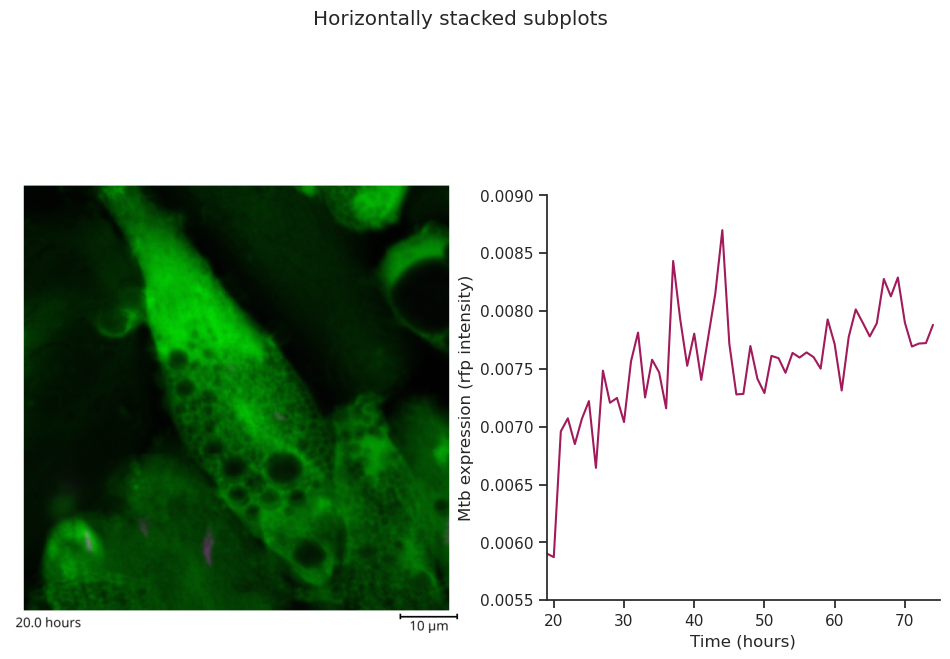

In [103]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12,8), gridspec_kw={'width_ratios': [1.15, 1]})
fig.suptitle('Horizontally stacked subplots')
ax1.imshow(imread(f'/home/dayn/Videos/tb_mp4s/glimpses/pierre_data/jan_22/glimpse_431_seq/t_{t+1}.tiff'))

ax1.axis('off')
ax2.plot(cell_ID_431['Time'], cell_ID_431['Intracellular Mtb content'].interpolate(), c = palette[1])
ax2.set_aspect(140/0.0085)
ax2.set(xlabel = 'Time (hours)', ylabel = 'Mtb expression (rfp intensity)', ylim=(0.0055,0.009), xlim = (19,75))
sns.despine()
# plt.savefig(f'/home/dayn/Videos/tb_mp4s/glimpses/pierre_data/jan_22/431_animated_graph/t_{t}')

In [ ]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12,8), gridspec_kw={'width_ratios': [1.15, 1]})
fig.suptitle('Horizontally stacked subplots')
ax1.imshow(imread(f'/home/dayn/Videos/tb_mp4s/glimpses/pierre_data/jan_22/glimpse_431_seq/t_{t+1}.tiff'))

ax1.axis('off')
ax2.plot(cell_ID_431['Time'], cell_ID_431['Intracellular Mtb content'].interpolate(), c = palette[1])
ax2.set_aspect(140/0.0085)
ax2.set(xlabel = 'Time (hours)', ylabel = 'Mtb expression (rfp intensity)', ylim=(0.0055,0.009), xlim = (19,75))
sns.despine()
# plt.savefig(f'/home/dayn/Videos/tb_mp4s/glimpses/pierre_data/jan_22/431_animated_graph/t_{t}')

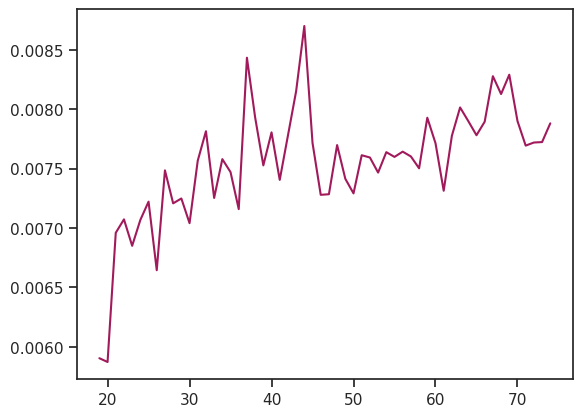

In [175]:
plt.plot(cell_ID_431['Time'], cell_ID_431['Intracellular Mtb content'].interpolate(), c = palette[1])

/tmp/ipykernel_478915/2376186731.py:1: DeprecationWarning: Please use `gaussian_filter1d` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  from scipy.ndimage.filters import gaussian_filter1d


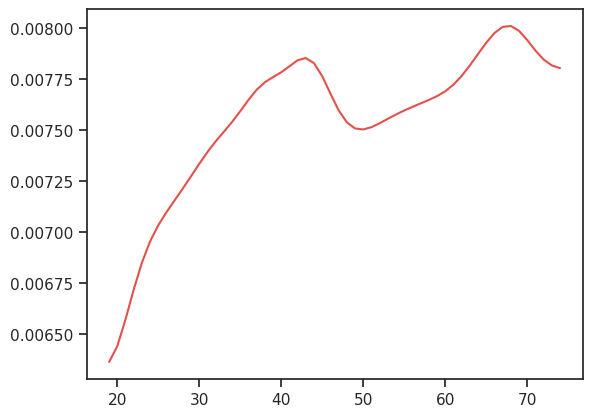

In [222]:
from scipy.ndimage.filters import gaussian_filter1d
y = cell_ID_431['Intracellular Mtb content'].interpolate()
ysmoothed = gaussian_filter1d(y, sigma=2.5
                             )
plt.plot(x, ysmoothed)
plt.show()


### Save out image sequence

  0%|          | 0/56 [00:00<?, ?it/s]

/tmp/ipykernel_478915/2598921118.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12,8), gridspec_kw={'width_ratios': [1.15, 1]})


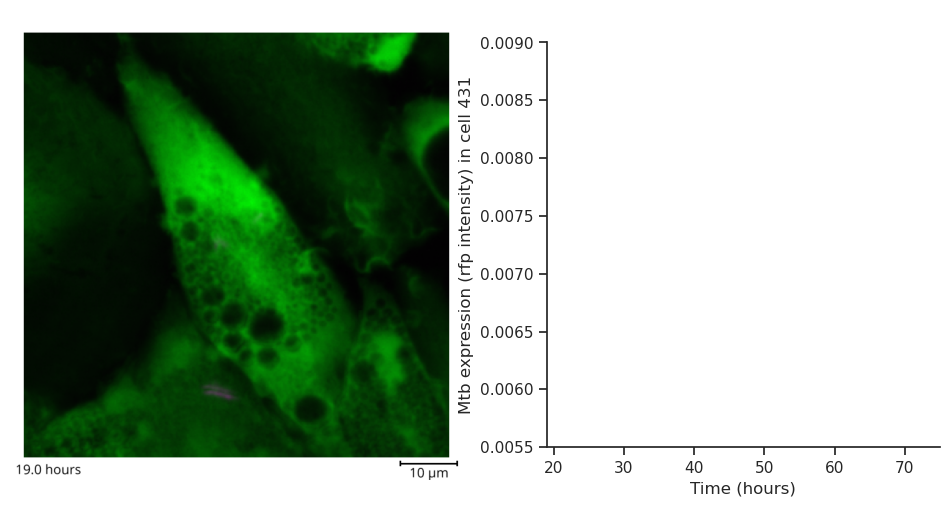

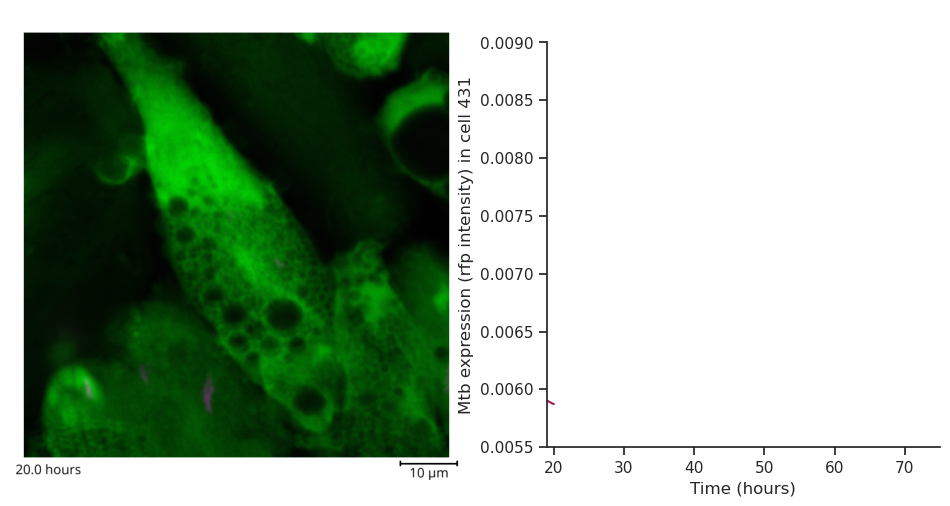

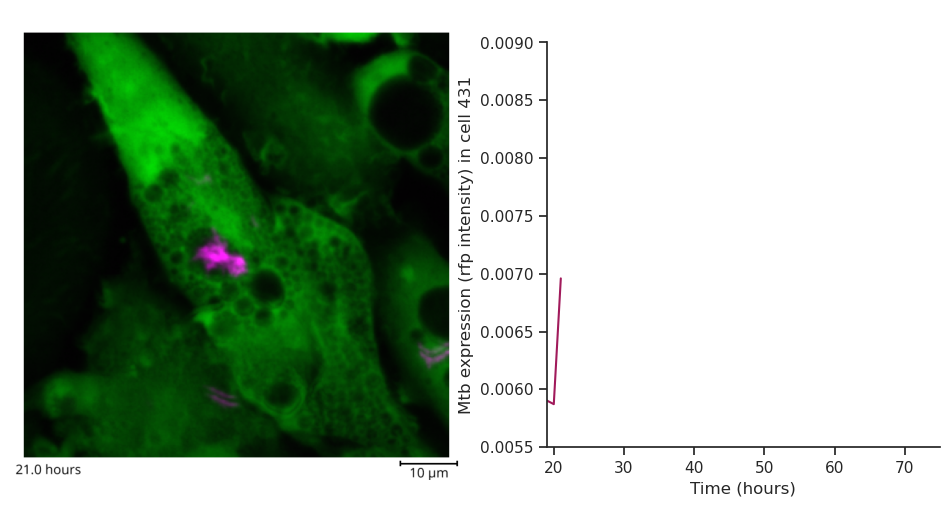

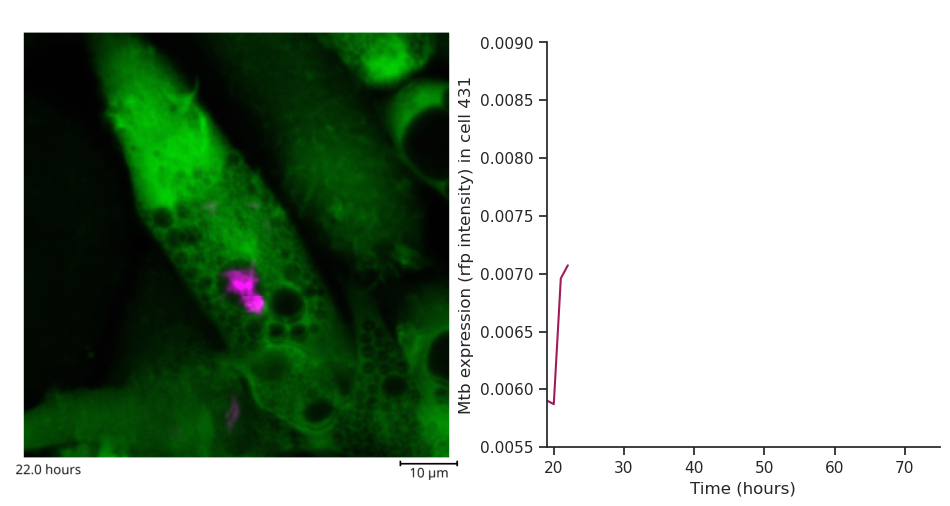

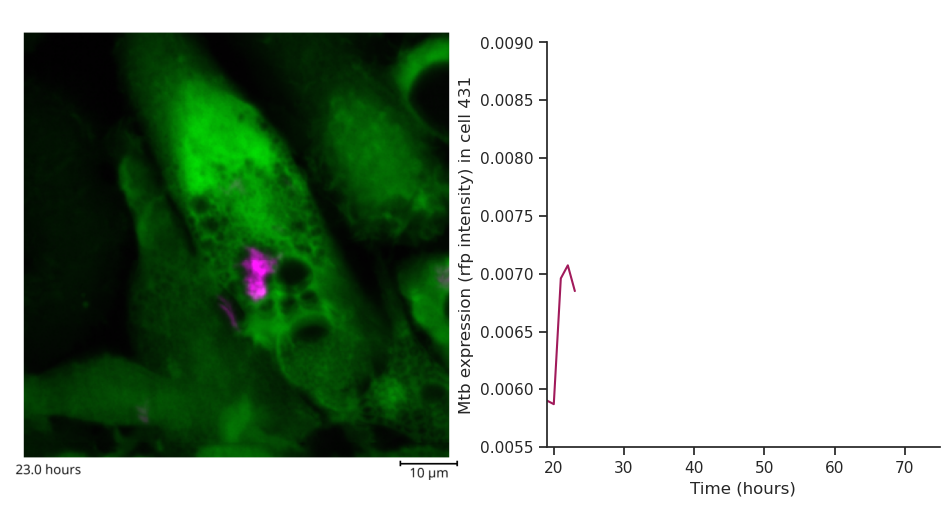

...

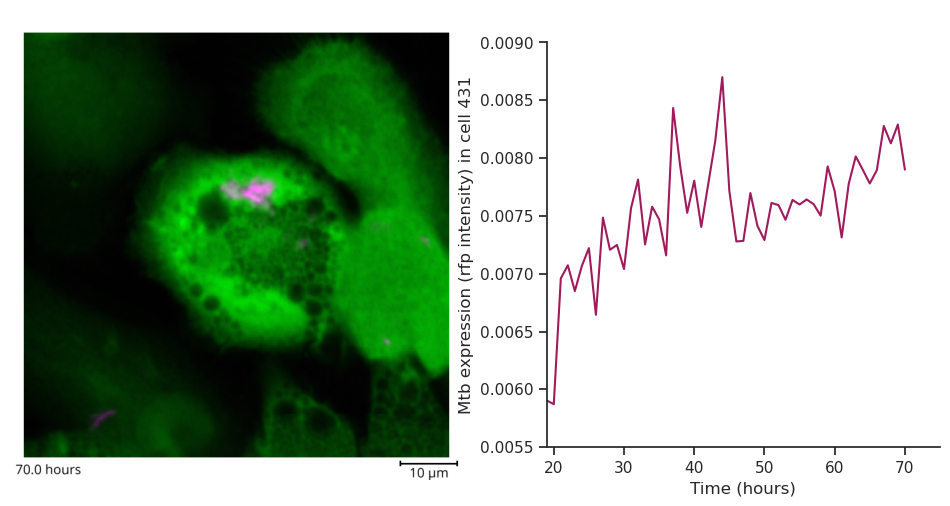

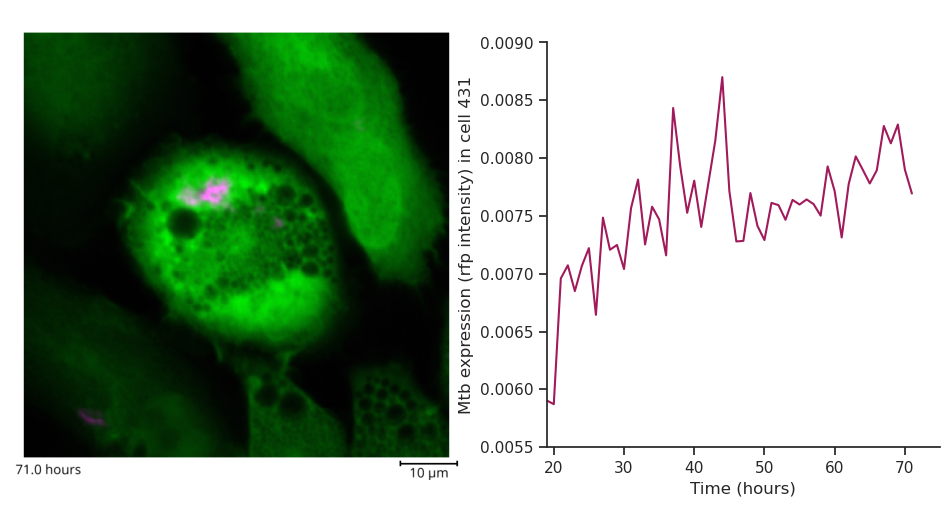

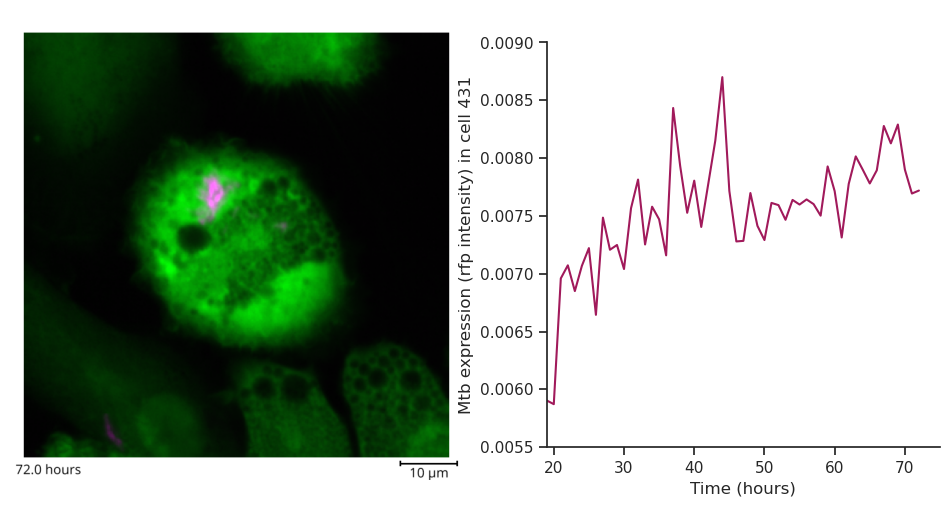

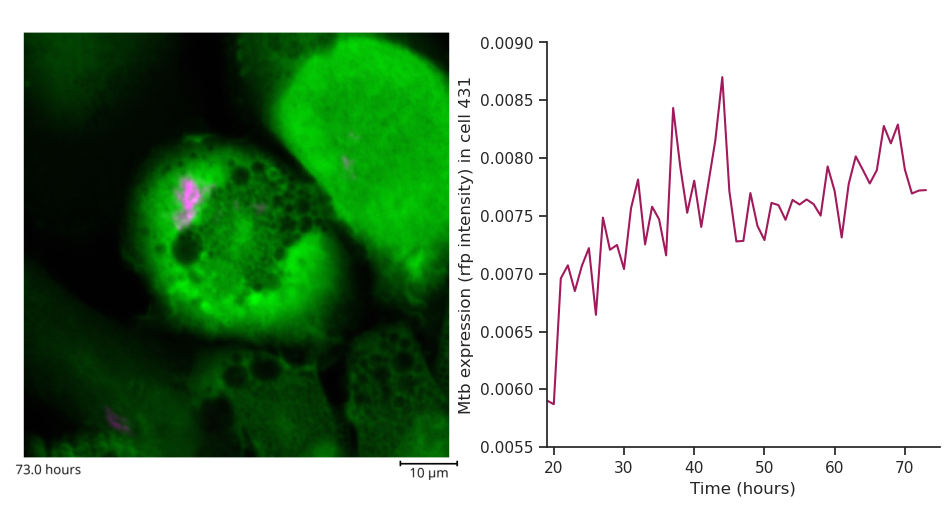

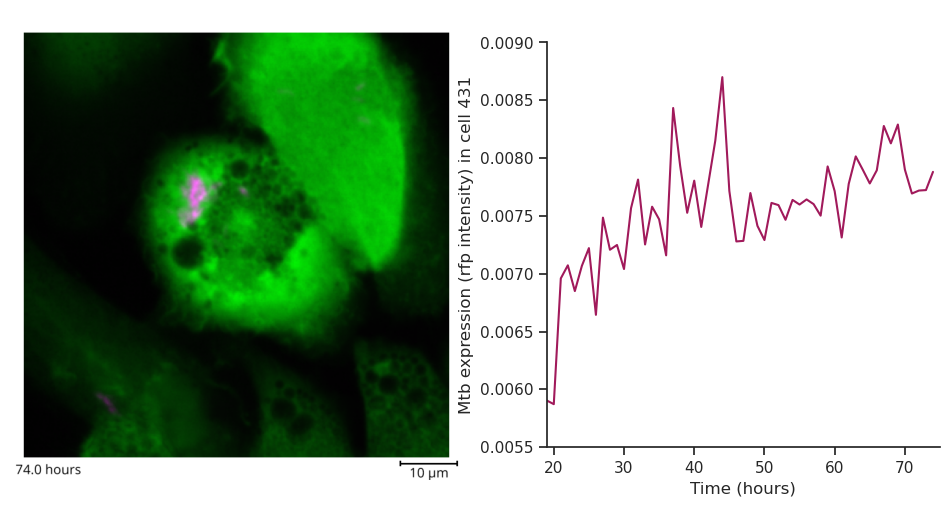

In [155]:
for n, row in tqdm(enumerate(cell_ID_431.iterrows()), total = len(cell_ID_431)):
    x = list(cell_ID_431['Time'].iloc[0:n+1])
    y = list(cell_ID_431['Intracellular Mtb content'].iloc[0:n+1].interpolate())
    t = row[1]['Time'] 
    ID = row[1]['Cell ID']
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12,8), gridspec_kw={'width_ratios': [1.15, 1]})
#     fig.suptitle(f'Cell ID: {ID}')
    ax1.imshow(imread(f'/home/dayn/Videos/tb_mp4s/glimpses/pierre_data/jan_22/glimpse_431_seq/t_{t}.tiff'))

    ax1.axis('off')
    ax2.plot(x, y, c = palette[1])
    ax2.set_aspect(140/0.0085)
    ax2.set(xlabel = 'Time (hours)', ylabel = f'Mtb expression (rfp intensity) in cell {ID}', ylim=(0.0055,0.009), xlim = (19,75))
    sns.despine()
    plt.savefig(f'/home/dayn/Videos/tb_mp4s/glimpses/pierre_data/jan_22/431_animated_graph/t_{t}.png', bbox_inches = 'tight', dpi = 314)

In [227]:
y[0:n+1]

array([0.00636229, 0.00644035, 0.00657103, 0.00671749, 0.00684951,
       0.00695395, 0.00703335, 0.0070975 , 0.00715579, 0.0072139 ,
       0.00727387, 0.0073346 , 0.00739261, 0.00744482, 0.00749219,
       0.00753999, 0.00759274, 0.00764831, 0.00769812, 0.00773479,
       0.00776009, 0.00778384, 0.00781335, 0.00784271, 0.00785349,
       0.00782799, 0.0077641 , 0.00767869, 0.00759697, 0.00753807,
       0.00750822, 0.00750314, 0.00751433, 0.00753376, 0.00755562,
       0.00757676, 0.00759612, 0.00761396, 0.00763095, 0.00764791,
       0.00766664, 0.00769037, 0.00772281, 0.00776566, 0.00781725,
       0.00787341, 0.00792869, 0.00797602, 0.00800621, 0.00801066,
       0.00798685, 0.00794195, 0.00789033, 0.0078462 , 0.00781722,
       0.0078038 ])

  0%|          | 0/56 [00:00<?, ?it/s]

/tmp/ipykernel_478915/2172754393.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12,8), gridspec_kw={'width_ratios': [1.15, 1]})


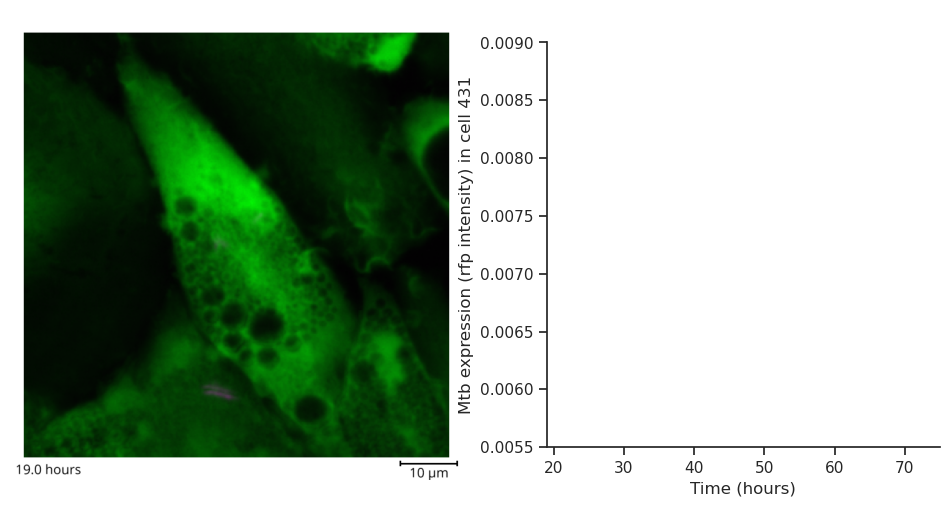

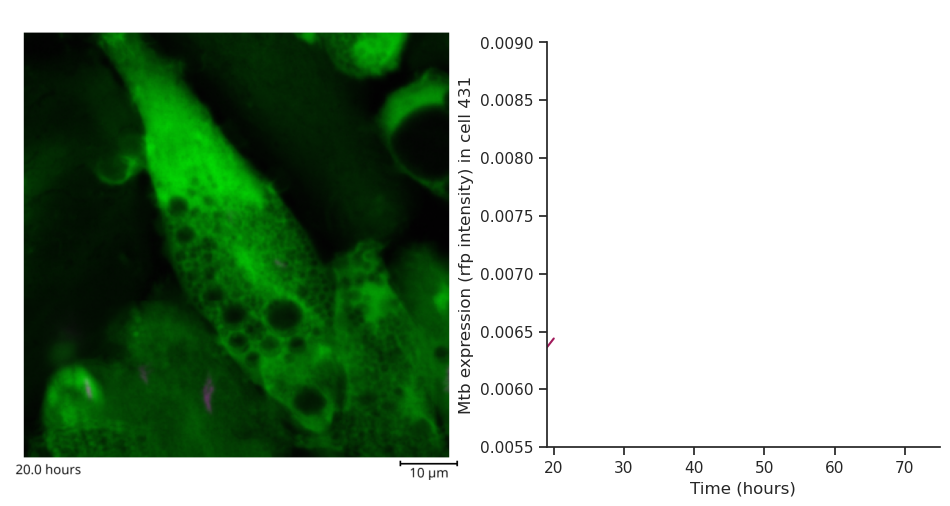

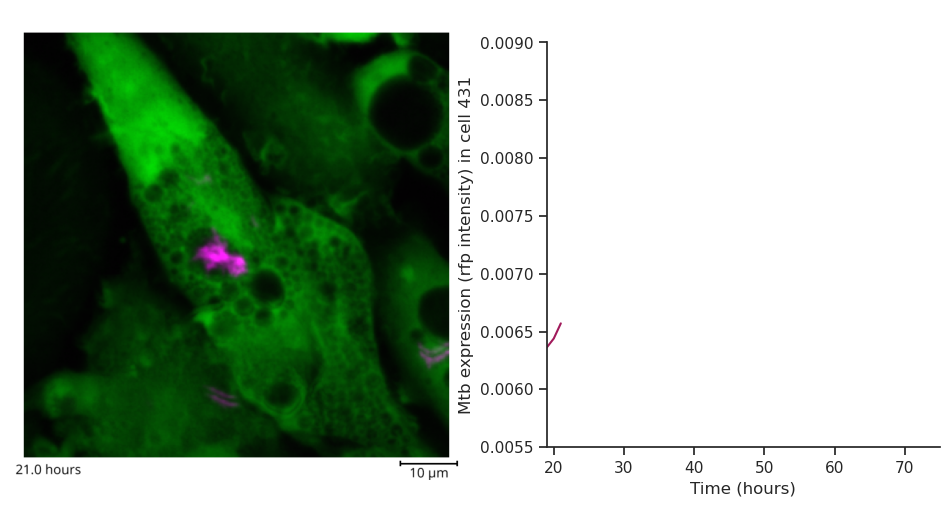

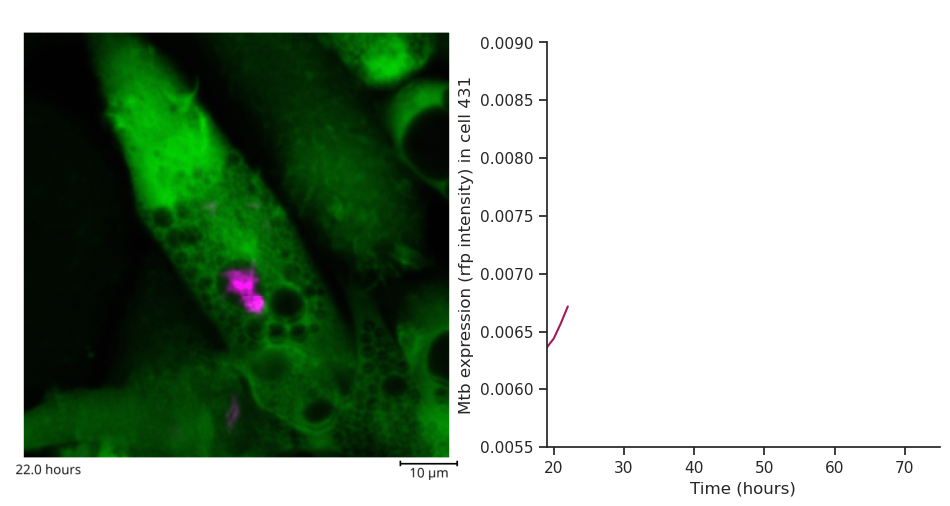

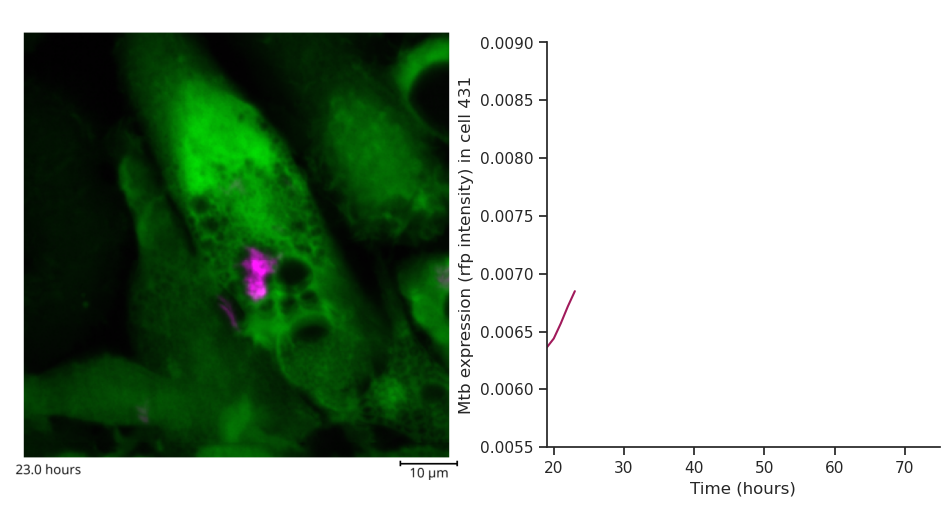

...

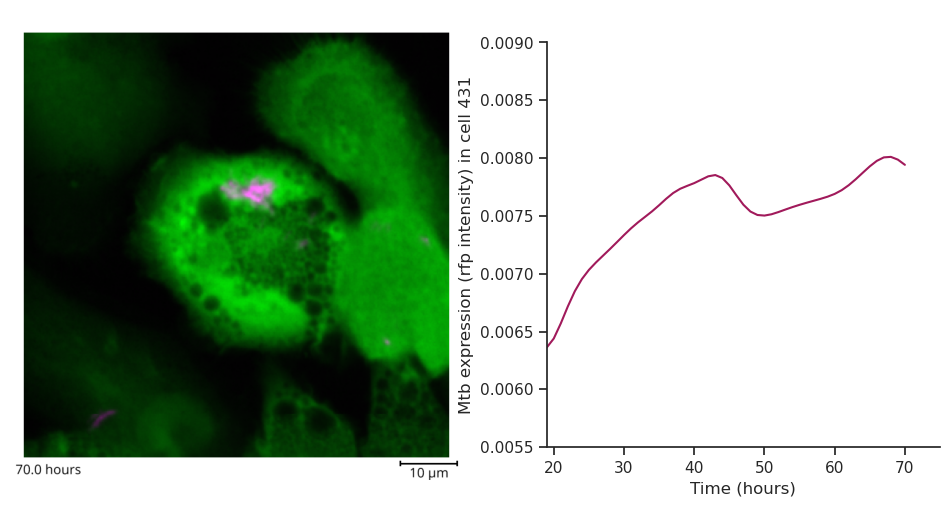

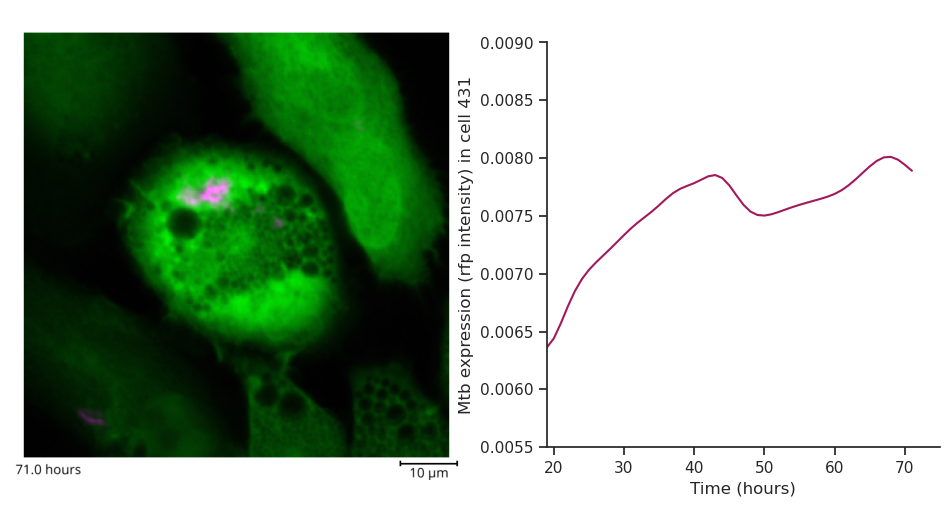

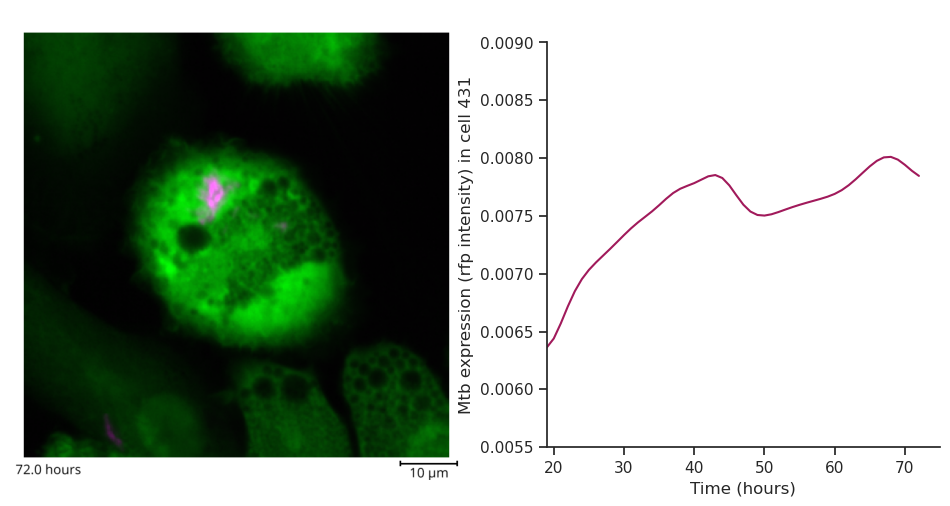

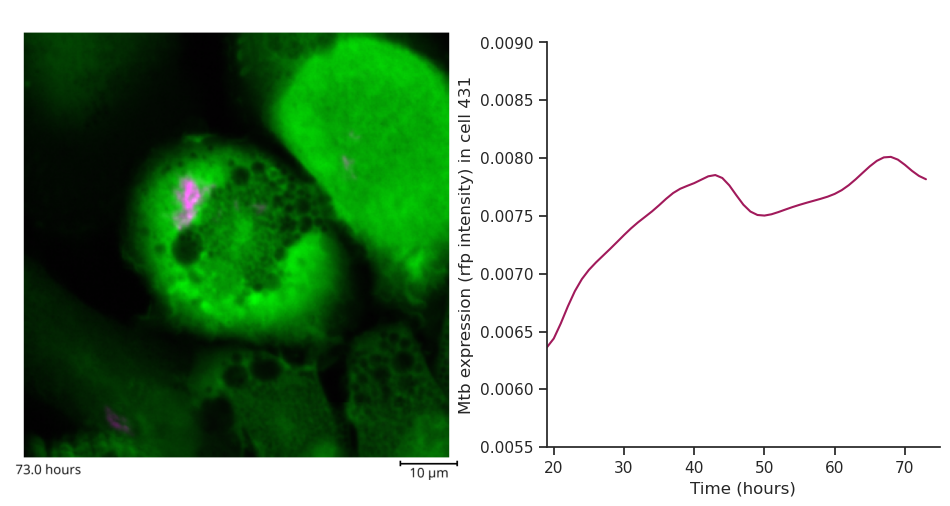

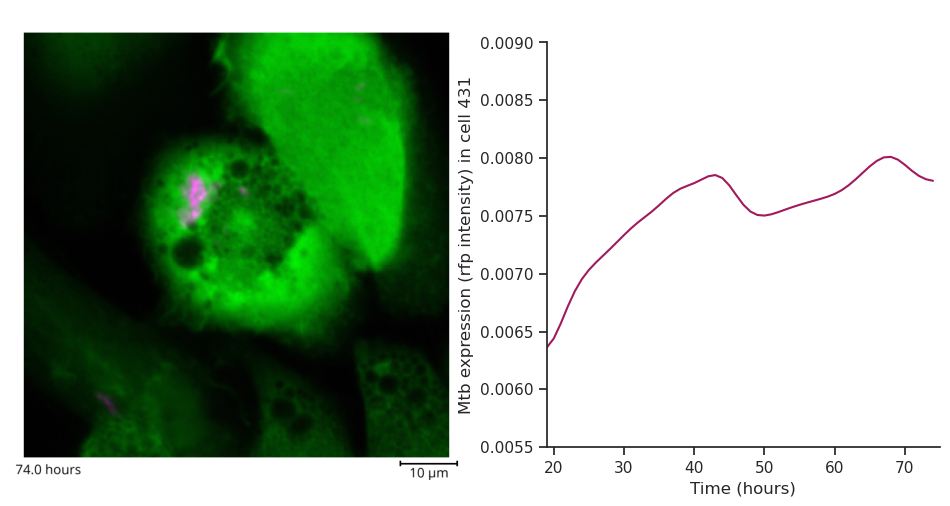

In [228]:
y = list(cell_ID_431['Intracellular Mtb content'].interpolate())
y = gaussian_filter1d(y, sigma=2.5)
for n, row in tqdm(enumerate(cell_ID_431.iterrows()), total = len(cell_ID_431)):
#     x = list(cell_ID_431['Time'].iloc[0:n+1])
#     y = list(cell_ID_431['Intracellular Mtb content'].iloc[0:n+1].interpolate())
#     y = gaussian_filter1d(y, sigma=2.5)
    x = list(cell_ID_431['Time'].iloc[0:n+1])
    
    plot_y = y[0:n+1]

    t = row[1]['Time'] 
    ID = row[1]['Cell ID']
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12,8), gridspec_kw={'width_ratios': [1.15, 1]})
#     fig.suptitle(f'Cell ID: {ID}')
    ax1.imshow(imread(f'/home/dayn/Videos/tb_mp4s/glimpses/pierre_data/jan_22/glimpse_431_seq/t_{t}.tiff'))

    ax1.axis('off')
    ax2.plot(x, plot_y, c = palette[1])
    ax2.set_aspect(140/0.0085)
    ax2.set(xlabel = 'Time (hours)', ylabel = f'Mtb expression (rfp intensity) in cell {ID}', ylim=(0.0055,0.009), xlim = (19,75))
    sns.despine()
    plt.savefig(f'/home/dayn/Videos/tb_mp4s/glimpses/pierre_data/jan_22/431_animated_graph/smooth_t_{t}.png', bbox_inches = 'tight', dpi = 314)

## Compile into mp4

In [171]:
import glob
from natsort import natsorted
from napari_animation import Animation

In [ ]:
plots = list()
for fn in tqdm(natsorted(glob.glob('/home/dayn/Videos/tb_mp4s/glimpses/pierre_data/jan_22/431_animated_graph/smooth_t_*.png')), total = 56):
    plot = imread(fn)
    plots.append(plot)
plots = np.stack(plots, axis = 0)

In [230]:
cam_coords = viewer.camera.center
zoom = viewer.camera.zoom

In [231]:
fn = '/home/dayn/Videos/tb_mp4s/glimpses/pierre_data/jan_22/431_smooth_animated_graph.mp4'

In [233]:
viewer = napari.Viewer()
viewer.add_image(plots)#, channel_axis = 0, colormap= ['green', 'magenta'], scale = scale
            #    )
viewer.theme = 'light'
# viewer.scale_bar.visible = True
# viewer.scale_bar.unit = 'm'
# viewer.scale_bar.font_size = text_size
# viewer.text_overlay.visible = True
# viewer.text_overlay.color = 'black'
# viewer.text_overlay.position = 'bottom_left'
# viewer.text_overlay.font_size = text_size
# viewer.dims.events.current_step.connect(update_slider)

animation = Animation(viewer)
viewer.update_console({'animation': animation})
# # viewer.camera.center = (0, 0, 3024, 3024)
viewer.dims.current_step = (0, cam_coords[-2], cam_coords[-1])
viewer.camera.zoom = zoom
animation.capture_keyframe(steps = 100)
viewer.dims.current_step = (55.0,  cam_coords[-2], cam_coords[-1])
animation.capture_keyframe(steps = 100)

animation.animate(fn, 
                  canvas_only=True,
                  fps = 5,
                  quality = 9)
viewer.close()

/home/dayn/miniconda3/envs/aero/lib/python3.9/site-packages/napari_tools_menu/__init__.py:194: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  self.tools_menu = ToolsMenu(self, self.qt_viewer.viewer)


Rendering frames...


100%|████████████████████████████████████████████████████████████████| 101/101 [00:05<00:00, 17.61it/s]


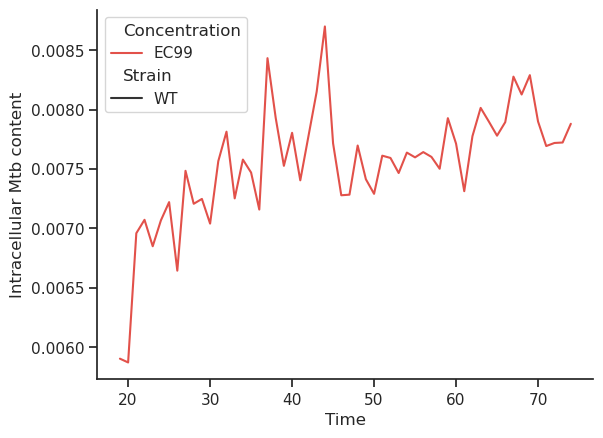

In [43]:
sns.lineplot( data=cell_ID_431,
                x = 'Time', 
                y = 'Intracellular Mtb content', 
                 hue = 'Concentration',
             style="Strain",)
sns.despine()

TypeError: inner() got multiple values for argument 'ax'

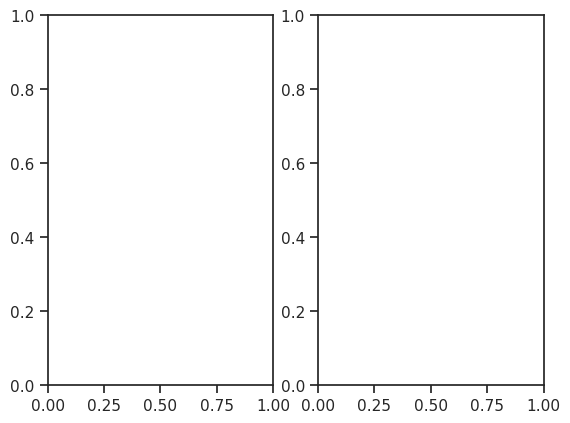

In [49]:
# plt.rcParams["figure.figsize"] = [7.00, 3.50]
# plt.rcParams["figure.autolayout"] = True
f, axes = plt.subplots(1, 2)
plt.imshow(imread('/home/dayn/Videos/tb_mp4s/glimpses/pierre_data/jan_22/glimpse_431_seq/t_20.tiff'),
           ax = axes[0])
sns.lineplot(data = cell_ID_431,
             x = 'Time', 
             y = 'Intracellular Mtb content', 
             hue = 'Concentration',
             style="Strain", 
             ax = axes[1])
sns.despine()
plt.show()

# Handpicking cells

In [151]:
IDs = [2239, 86, 969, 370, ### high int
      275, 287, 211, 245] ### low int

In [152]:
interest_tracks = [track for track in tracks if track.ID in IDs]

  0%|          | 0/8 [00:00<?, ?it/s]

Text(0, 0.5, 'Intracellular Mtb content \n(Relative fluorescent intensity)')

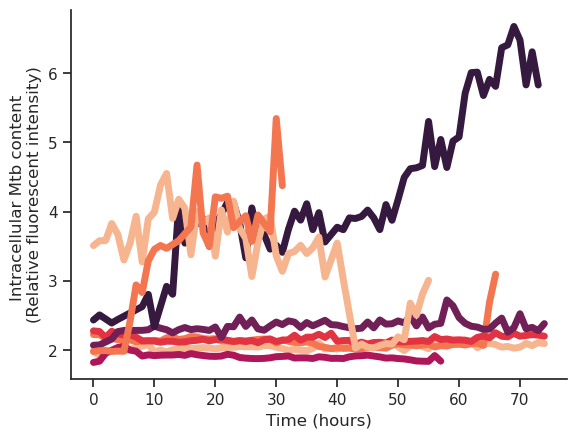

In [197]:
for n, i in tqdm(enumerate(interest_tracks), total = len(interest_tracks)):
    label = f'Cell ID {i.ID}'
    sns.lineplot(data = i.properties['mean_intensity-1']/1E-17, 
#                      label =label, 
                     linewidth = 5
                      )
    sns.despine(offset=0) 
plt.xlabel('Time (hours)')
plt.ylabel('Intracellular Mtb content \n(Relative fluorescent intensity)')

# Smoothing

In [172]:
import pandas as pd

In [175]:
list(pd.Series(y).interpolate())

[1.8238063978338412,
 1.8423547041213306,
 1.9558947199437107,
 1.9979902656557842,
 2.0400858113678577,
 2.059135158518671,
 2.0026590888096947,
 1.9866685577606347,
 1.9162170584960105,
 1.9332179297486083,
 1.9224011062918793,
 1.9286831859956515,
 1.9310088618486023,
 1.9312014530688792,
 1.9391299071725172,
 1.926223490471384,
 1.9521400001465095,
 1.9351059714077221,
 1.9235906701330927,
 1.913669931566415,
 1.9109942066963226,
 1.9162477279734182,
 1.9418001774807818,
 1.9282658015907763,
 1.8955693773972453,
 1.8861938177842865,
 1.8806517845821817,
 1.8793597979245373,
 1.882248709220338,
 1.891039996952278,
 1.907390656404174,
 1.9107558689911304,
 1.9166916117996264,
 1.8881159404562442,
 1.8900657758384352,
 1.889373671892682,
 1.8808417085085438,
 1.9054035575194062,
 1.8981143288228348,
 1.8825927807260852,
 1.8837164873296874,
 1.8801693171757305,
 1.9052384776333728,
 1.9168910754017714,
 1.9207964926917096,
 1.929257111630691,
 1.9162512325407344,
 1.9043637886827662,


  0%|          | 0/8 [00:00<?, ?it/s]

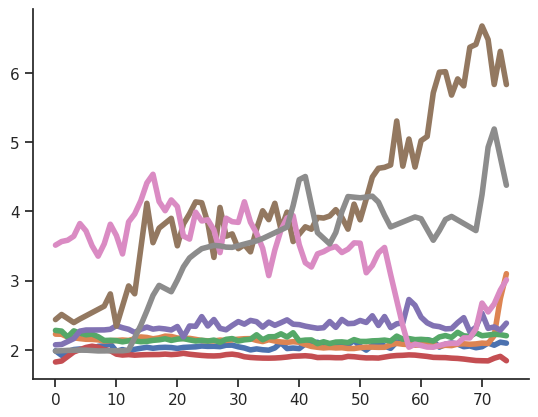

In [185]:
from scipy.interpolate import make_interp_spline, BSpline


for n, i in tqdm(enumerate(interest_tracks), total = len(interest_tracks)):
    x = i.t
    y = i.properties['mean_intensity-1']/1E-17
    y = list(pd.Series(y).interpolate())
    xnew = np.linspace(np.min(x), np.max(x), 75) 
    spl = make_interp_spline(x, y, k=1)
    y_smooth = spl(xnew)
    sns.lineplot(data =y_smooth, 
#                      label =label, 
                     linewidth = 4
                      )
    sns.despine(offset=0) 